
<div style="background-color: #0c6f53; color: #f0f0f0; padding: 10px;">

# **Human Resources Analysis Predict Attrition**

</div>

<div style="background-color: #f0f0f0; color: #000000; padding: 10px;">
  <strong>Project Contributors</strong>
  <ul>
    <li>Gonçalo Alves</li>
    <li>Gonçalo Eloy</li>
    <li>Maria Beatriz Amado</li>
    <li>Mariana Pereira</li>
  </ul>
</div>

<div style="background-color: #92d050; color: white; padding: 10px;">
<a id='scrub'>
<h3 style="color: white;"><strong>Introduction</strong></h3>
</a>
</div>

This project aims to predict employee attrition within a specific company's workforce. 

As data scientists, our goal is to create a model that estimates the likelihood of an employee staying or quitting based on their characteristics. 

Despite the complexity and incomplete data, our model will assist the HR team in taking preventive measures to reduce attrition, such as adjusting salaries, promoting engaging projects, and offering remote work options. This project provides a valuable opportunity to explore feature extraction from diverse data sources and addresses key questions for a multinational consultancy firm regarding employee retention. 

Our main objectives encompass descriptive analytics to uncover correlations and predictive analytics to build classification models for attrition prediction.


In [490]:
#pip install --upgrade pip
#pip install pandas
#pip install matplotlib
#pip install seaborn

In [491]:
#pip install scikit-learn


<a id='toc'></a>

### Table of Contents
* [1. Obtain Data](#obtain) <br>
    * [1.1 Load libraries](#lib)<br>
    * [1.2. Import data](#import)<br>
    * [1.3. Dimensionality of the dataframe](#dim)<br>
    * [1.4. Check missing values](#miss)<br>

* [2. Scrub data](#scrub) <br>
    * [2.1. Information about columns](#info) <br>
    * [2.2. Checking duplicate values](#duplicates)<br>
    * [2.3. Missing values](#var)<br>
        * [2.3.1. Categorical Variables](#cat)<br>
        * [2.3.2. Numerical Variables](#num)<br>
    * [2.4. Data Cleaning: Outliers](#out)<br> 

* [3. Explore data](#explore) <br>
        * [3.1. Basic Exploration](#exp)<br>
        * [3.2. Data Visualization](#vis)<br>
        * [3.3. Statistical Exploration](#stat)<br>


* [4. Model](#model) <br>
* [5. Interpret](#int) <br>





<div style="background-color: #92d050; color: white; padding: 10px;">
<a id='scrub'>
<h3 style="color: white;"><strong>1. Obtain Data</strong></h3>
</a>
</div>

**__`1.1`__ Load Libraries**

<a id='lib'></a>


In [492]:
# General Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Preprocessing Libraries
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MinMaxScaler
from imblearn.over_sampling import RandomOverSampler
from imblearn.combine import SMOTEENN
from sklearn.preprocessing import StandardScaler
from sklearn.feature_selection import RFE
from sklearn.linear_model import LassoCV 
from scipy import stats

# Model Libraries
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from lightgbm import LGBMClassifier
import xgboost as xgb
from sklearn.svm import SVC
from catboost import CatBoostClassifier
from keras.models import Sequential
from keras.layers import Dense, BatchNormalization
import tensorflow as tf
from tensorflow.keras.callbacks import ReduceLROnPlateau
from sklearn.metrics import precision_recall_fscore_support
from tensorflow.keras.layers import Dropout

# Evaluation Libraries
from sklearn.metrics import confusion_matrix, accuracy_score, roc_curve, roc_auc_score
from sklearn.metrics import recall_score, f1_score, precision_score
from sklearn.metrics import classification_report
from imblearn.metrics import geometric_mean_score

# Other Utilities
from sklearn.model_selection import train_test_split, StratifiedKFold, GridSearchCV, ParameterGrid
from sklearn.utils import class_weight
from imblearn.pipeline import Pipeline
import joblib
import warnings
warnings.filterwarnings('ignore')

**__`1.2`__ Import data**

<a id='import'></a>

In [493]:
data= pd.read_csv("https://raw.githubusercontent.com/beatrizamado/HR-Analysis/main/HR_DS.csv")
data

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1465,36,No,Travel_Frequently,884,Research & Development,23,2,Medical,1,2061,...,3,80,1,17,3,3,5,2,0,3
1466,39,No,Travel_Rarely,613,Research & Development,6,1,Medical,1,2062,...,1,80,1,9,5,3,7,7,1,7
1467,27,No,Travel_Rarely,155,Research & Development,4,3,Life Sciences,1,2064,...,2,80,1,6,0,3,6,2,0,3
1468,49,No,Travel_Frequently,1023,Sales,2,3,Medical,1,2065,...,4,80,0,17,3,2,9,6,0,8


**__`1.3`__ Dimensionality of the dataframe**

<a id='dim'></a>

In [494]:
data.shape

(1470, 35)

In [495]:
data['Attrition'].value_counts()

Attrition
No     1233
Yes     237
Name: count, dtype: int64

O dataset é unbalanced. Significa que vamos ter de fazer um resampling/ k-fold stratified cross validation e afins

**__`1.4`__ Checking missing values**

<a id='miss'></a>

In [496]:
data.isna().sum()

Age                         0
Attrition                   0
BusinessTravel              0
DailyRate                   0
Department                  0
DistanceFromHome            0
Education                   0
EducationField              0
EmployeeCount               0
EmployeeNumber              0
EnvironmentSatisfaction     0
Gender                      0
HourlyRate                  0
JobInvolvement              0
JobLevel                    0
JobRole                     0
JobSatisfaction             0
MaritalStatus               0
MonthlyIncome               0
MonthlyRate                 0
NumCompaniesWorked          0
Over18                      0
OverTime                    0
PercentSalaryHike           0
PerformanceRating           0
RelationshipSatisfaction    0
StandardHours               0
StockOptionLevel            0
TotalWorkingYears           0
TrainingTimesLastYear       0
WorkLifeBalance             0
YearsAtCompany              0
YearsInCurrentRole          0
YearsSince

<div style="background-color: #92d050; color: white; padding: 10px;">
<a id='scrub'>
<h3 style="color: white;"><strong>2. Describe Data</strong></h3>
</a>
</div>


**__`2.1`__ Information about columns**

<a id='info'></a>

In [497]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 35 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   Age                       1470 non-null   int64 
 1   Attrition                 1470 non-null   object
 2   BusinessTravel            1470 non-null   object
 3   DailyRate                 1470 non-null   int64 
 4   Department                1470 non-null   object
 5   DistanceFromHome          1470 non-null   int64 
 6   Education                 1470 non-null   int64 
 7   EducationField            1470 non-null   object
 8   EmployeeCount             1470 non-null   int64 
 9   EmployeeNumber            1470 non-null   int64 
 10  EnvironmentSatisfaction   1470 non-null   int64 
 11  Gender                    1470 non-null   object
 12  HourlyRate                1470 non-null   int64 
 13  JobInvolvement            1470 non-null   int64 
 14  JobLevel                

In [498]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
Age,1470.0,36.923810,9.135373,18.0,30.00,36.0,43.00,60.0
DailyRate,1470.0,802.485714,403.509100,102.0,465.00,802.0,1157.00,1499.0
DistanceFromHome,1470.0,9.192517,8.106864,1.0,2.00,7.0,14.00,29.0
Education,1470.0,2.912925,1.024165,1.0,2.00,3.0,4.00,5.0
EmployeeCount,1470.0,1.000000,0.000000,1.0,1.00,1.0,1.00,1.0
EmployeeNumber,1470.0,1024.865306,602.024335,1.0,491.25,1020.5,1555.75,2068.0
EnvironmentSatisfaction,1470.0,2.721769,1.093082,1.0,2.00,3.0,4.00,4.0
HourlyRate,1470.0,65.891156,20.329428,30.0,48.00,66.0,83.75,100.0
JobInvolvement,1470.0,2.729932,0.711561,1.0,2.00,3.0,3.00,4.0
JobLevel,1470.0,2.063946,1.106940,1.0,1.00,2.0,3.00,5.0


**__`2.2`__ Checking duplicates**

<a id='duplicates'></a>

In [499]:
duplicates=data[data.duplicated()] # save all duplicate rows
print("There are {} duplicates.".format(list(data.duplicated()).count(True)))
data.drop_duplicates(inplace = True) #remove duplicates

data.reset_index(inplace=True)
data.drop("index", inplace=True, axis=1)
print("\n")
print("All the duplicates were saved in a dataframe named:'Duplicates'")

There are 0 duplicates.


All the duplicates were saved in a dataframe named:'Duplicates'


In [500]:
data.set_index('EmployeeNumber', inplace = True)

**__`2.3`__ Missing values**

<a id='var'></a>

In [501]:
categoricalVar = data.select_dtypes(include=['object']).columns.tolist()
numericalVar= data.select_dtypes(exclude=['object']).columns.tolist()

print("\nThe numerical variables are: \n{}.".format((numericalVar)))
print("\nThe non-numerical variables are:\n{}.".format(categoricalVar))

print("\nIn summary:")
pd.DataFrame(([categoricalVar, numericalVar]),index = ['Categorical Variables', 'Numerical Variables']).T


The numerical variables are: 
['Age', 'DailyRate', 'DistanceFromHome', 'Education', 'EmployeeCount', 'EnvironmentSatisfaction', 'HourlyRate', 'JobInvolvement', 'JobLevel', 'JobSatisfaction', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked', 'PercentSalaryHike', 'PerformanceRating', 'RelationshipSatisfaction', 'StandardHours', 'StockOptionLevel', 'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance', 'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion', 'YearsWithCurrManager'].

The non-numerical variables are:
['Attrition', 'BusinessTravel', 'Department', 'EducationField', 'Gender', 'JobRole', 'MaritalStatus', 'Over18', 'OverTime'].

In summary:


,Categorical Variables,Numerical Variables
0,Attrition,Age
1,BusinessTravel,DailyRate
2,Department,DistanceFromHome
3,EducationField,Education
4,Gender,EmployeeCount
5,JobRole,EnvironmentSatisfaction
6,MaritalStatus,HourlyRate
7,Over18,JobInvolvement
8,OverTime,JobLevel
9,None,JobSatisfaction


**__`2.3.1.`__ Categorical Variables**

<a id='cat'></a>

In [502]:
pd.DataFrame(data[categoricalVar]).describe()

,Attrition,BusinessTravel,Department,EducationField,Gender,JobRole,MaritalStatus,Over18,OverTime
count,1470,1470,1470,1470,1470,1470,1470,1470,1470
unique,2,3,3,6,2,9,3,1,2
top,No,Travel_Rarely,Research & Development,Life Sciences,Male,Sales Executive,Married,Y,No
freq,1233,1043,961,606,882,326,673,1470,1054


* **Attrition**

In [503]:
null_count = data["Attrition"].isnull().sum()
print("There are {} nulls.".format(null_count))
print("\n")
unique_values = data["Attrition"].unique()
print("The unique values in the Attrition are: {}.".format(unique_values))
print("\n")

There are 0 nulls.


The unique values in the Attrition are: ['Yes' 'No'].




In [504]:

label_encoder = LabelEncoder()

data['Attrition_Num'] = label_encoder.fit_transform(data['Attrition'])


In [505]:
data['Attrition_Num']

EmployeeNumber
1       1
2       0
4       1
5       0
7       0
       ..
2061    0
2062    0
2064    0
2065    0
2068    0
Name: Attrition_Num, Length: 1470, dtype: int32

In [506]:
data

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EnvironmentSatisfaction,...,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition_Num
EmployeeNumber,,,,,,,,,,,,,,,,,,,,,
1,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,2,...,80,0,8,0,1,6,4,0,5,1
2,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,3,...,80,1,10,3,3,10,7,1,7,0
4,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,80,0,7,3,3,0,0,0,0,1
5,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,4,...,80,0,8,3,3,8,7,3,0,0
7,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,1,...,80,1,6,3,3,2,2,2,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2061,36,No,Travel_Frequently,884,Research & Development,23,2,Medical,1,3,...,80,1,17,3,3,5,2,0,3,0
2062,39,No,Travel_Rarely,613,Research & Development,6,1,Medical,1,4,...,80,1,9,5,3,7,7,1,7,0
2064,27,No,Travel_Rarely,155,Research & Development,4,3,Life Sciences,1,2,...,80,1,6,0,3,6,2,0,3,0


In [507]:
data = data.drop('Attrition', axis=1)

In [508]:
data

,Age,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EnvironmentSatisfaction,Gender,...,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition_Num
EmployeeNumber,,,,,,,,,,,,,,,,,,,,,
1,41,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,2,Female,...,80,0,8,0,1,6,4,0,5,1
2,49,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,3,Male,...,80,1,10,3,3,10,7,1,7,0
4,37,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,Male,...,80,0,7,3,3,0,0,0,0,1
5,33,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,4,Female,...,80,0,8,3,3,8,7,3,0,0
7,27,Travel_Rarely,591,Research & Development,2,1,Medical,1,1,Male,...,80,1,6,3,3,2,2,2,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2061,36,Travel_Frequently,884,Research & Development,23,2,Medical,1,3,Male,...,80,1,17,3,3,5,2,0,3,0
2062,39,Travel_Rarely,613,Research & Development,6,1,Medical,1,4,Male,...,80,1,9,5,3,7,7,1,7,0
2064,27,Travel_Rarely,155,Research & Development,4,3,Life Sciences,1,2,Male,...,80,1,6,0,3,6,2,0,3,0


* **Business Travel**

In [509]:
null_count = data["BusinessTravel"].isnull().sum()
print("There are {} nulls.".format(null_count))
print("\n")
unique_values = data["BusinessTravel"].unique()
print("The unique values in the Business Travel are: {}.".format(unique_values))
print("\n")

There are 0 nulls.


The unique values in the Business Travel are: ['Travel_Rarely' 'Travel_Frequently' 'Non-Travel'].




In [510]:
def create_travel_column(row):
    if row['BusinessTravel'] == 'Non-Travel':
        return 1
    else:
        return 0

# Apply the function to create a new column 'travel'
data['Travel_Flag'] = data.apply(create_travel_column, axis=1)

In [511]:
data ['Travel_Flag'].value_counts()

Travel_Flag
0    1320
1     150
Name: count, dtype: int64

In [512]:
data = data.drop('BusinessTravel', axis=1)

* **Department**


In [513]:
null_count = data["Department"].isnull().sum()
print("There are {} nulls.".format(null_count))
print("\n")
unique_values = data["Department"].unique()
print("The unique values in the Department are: {}.".format(unique_values))
print("\n")

There are 0 nulls.


The unique values in the Department are: ['Sales' 'Research & Development' 'Human Resources'].




In [514]:
category_mapping = {
    'Sales': 1,
    'Research & Development': 2,
    'Human Resources': 0,
    
}

def create_department_column(row):
    return category_mapping.get(row['Department'], 0)  

data['Department_Flag'] = data.apply(create_department_column, axis=1)

In [515]:
data

,Age,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EnvironmentSatisfaction,Gender,HourlyRate,...,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition_Num,Travel_Flag,Department_Flag
EmployeeNumber,,,,,,,,,,,,,,,,,,,,,
1,41,1102,Sales,1,2,Life Sciences,1,2,Female,94,...,8,0,1,6,4,0,5,1,0,1
2,49,279,Research & Development,8,1,Life Sciences,1,3,Male,61,...,10,3,3,10,7,1,7,0,0,2
4,37,1373,Research & Development,2,2,Other,1,4,Male,92,...,7,3,3,0,0,0,0,1,0,2
5,33,1392,Research & Development,3,4,Life Sciences,1,4,Female,56,...,8,3,3,8,7,3,0,0,0,2
7,27,591,Research & Development,2,1,Medical,1,1,Male,40,...,6,3,3,2,2,2,2,0,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2061,36,884,Research & Development,23,2,Medical,1,3,Male,41,...,17,3,3,5,2,0,3,0,0,2
2062,39,613,Research & Development,6,1,Medical,1,4,Male,42,...,9,5,3,7,7,1,7,0,0,2
2064,27,155,Research & Development,4,3,Life Sciences,1,2,Male,87,...,6,0,3,6,2,0,3,0,0,2


* **Education Field**

In [516]:
null_count = data["EducationField"].isnull().sum()
print("There are {} nulls.".format(null_count))
print("\n")
unique_values = data["EducationField"].unique()
print("The unique values in the Education Field are: {}.".format(unique_values))
print("\n")

There are 0 nulls.


The unique values in the Education Field are: ['Life Sciences' 'Other' 'Medical' 'Marketing' 'Technical Degree'
 'Human Resources'].




In [517]:
category_mapping2 = {
    'Life Sciences': 1,
    'Medical': 2,
    'Marketing': 3,
    'Technical Degree': 4,
    'Human Resources':5,
    'Other': 0,
}

def create_edfield_column(row):
    return category_mapping2.get(row['EducationField'], 0)  

data['EducationField_Flag'] = data.apply(create_edfield_column, axis=1)

In [518]:
category_mapping = {
    'Sales Executive': 1,
    'Research Scientist': 2,      
    'Laboratory Technician':3,     
    'Manufacturing Director':4, 
    'Healthcare Representative':5,   
    'Manager':6,                
    'Sales Representative':7,       
    'Research Director':8,         
    'Human Resources':0,           
    
}

def create_jobrole_column(row):
    return category_mapping.get(row['JobRole'], 1)  

data['JobRole_Flag'] = data.apply(create_jobrole_column, axis=1)

In [519]:
category_mapping2 = {
    'Married': 1,
    'Divorced': 2,
    'Single': 0,
   
}

def create_edfield_column(row):
    return category_mapping2.get(row['MaritalStatus'], 0)  

data['MaritalStatus_Flag'] = data.apply(create_edfield_column, axis=1)

In [520]:
data['MaritalStatus'].value_counts()

MaritalStatus
Married     673
Single      470
Divorced    327
Name: count, dtype: int64

* **Gender**

In [521]:
null_count = data["Gender"].isnull().sum()
print("There are {} nulls.".format(null_count))
print("\n")
unique_values = data["Gender"].unique()
print("The unique values in the Gender are: {}.".format(unique_values))
print("\n")

There are 0 nulls.


The unique values in the Gender are: ['Female' 'Male'].




In [522]:

label_encoder = LabelEncoder()

data['Gender_Flag'] = label_encoder.fit_transform(data['Gender'])

In [523]:
data

,Age,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EnvironmentSatisfaction,Gender,HourlyRate,...,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager,Attrition_Num,Travel_Flag,Department_Flag,EducationField_Flag,JobRole_Flag,MaritalStatus_Flag,Gender_Flag
EmployeeNumber,,,,,,,,,,,,,,,,,,,,,
1,41,1102,Sales,1,2,Life Sciences,1,2,Female,94,...,4,0,5,1,0,1,1,1,0,0
2,49,279,Research & Development,8,1,Life Sciences,1,3,Male,61,...,7,1,7,0,0,2,1,2,1,1
4,37,1373,Research & Development,2,2,Other,1,4,Male,92,...,0,0,0,1,0,2,0,3,0,1
5,33,1392,Research & Development,3,4,Life Sciences,1,4,Female,56,...,7,3,0,0,0,2,1,2,1,0
7,27,591,Research & Development,2,1,Medical,1,1,Male,40,...,2,2,2,0,0,2,2,3,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2061,36,884,Research & Development,23,2,Medical,1,3,Male,41,...,2,0,3,0,0,2,2,3,1,1
2062,39,613,Research & Development,6,1,Medical,1,4,Male,42,...,7,1,7,0,0,2,2,5,1,1
2064,27,155,Research & Development,4,3,Life Sciences,1,2,Male,87,...,2,0,3,0,0,2,1,4,1,1


* **Job Role**

In [524]:
null_count = data["JobRole"].isnull().sum()
print("There are {} nulls.".format(null_count))
print("\n")
unique_values = data["JobRole"].unique()
print("The unique values in the Job Role are: {}.".format(unique_values))
print("\n")

There are 0 nulls.


The unique values in the Job Role are: ['Sales Executive' 'Research Scientist' 'Laboratory Technician'
 'Manufacturing Director' 'Healthcare Representative' 'Manager'
 'Sales Representative' 'Research Director' 'Human Resources'].




* **Marital Status**

In [525]:
null_count = data["MaritalStatus"].isnull().sum()
print("There are {} nulls.".format(null_count))
print("\n")
unique_values = data["MaritalStatus"].unique()
print("The unique values in the Marital Status are: {}.".format(unique_values))
print("\n")

There are 0 nulls.


The unique values in the Marital Status are: ['Single' 'Married' 'Divorced'].




* **Over 18**

In [526]:
null_count = data["Over18"].isnull().sum()
print("There are {} nulls.".format(null_count))
print("\n")
unique_values = data["Over18"].unique()
print("The unique values in the Over 18 are: {}.".format(unique_values))
print("\n")

There are 0 nulls.


The unique values in the Over 18 are: ['Y'].




In [527]:
over_18_column = data[['Over18']]

print(over_18_column)

               Over18
EmployeeNumber       
1                   Y
2                   Y
4                   Y
5                   Y
7                   Y
...               ...
2061                Y
2062                Y
2064                Y
2065                Y
2068                Y

[1470 rows x 1 columns]


* **Overtime**

In [528]:
null_count = data["OverTime"].isnull().sum()
print("There are {} nulls.".format(null_count))
print("\n")
unique_values = data["OverTime"].unique()
print("The unique values in the Overtime : {}.".format(unique_values))
print("\n")

There are 0 nulls.


The unique values in the Overtime : ['Yes' 'No'].




In [529]:
def create_overtime_column(row):
    if row['OverTime'] == 'Yes':
        return 1
    else:
        return 0

# Apply the function to create a new column 'travel'
data['OverTime_Flag'] = data.apply(create_overtime_column, axis=1)

In [530]:
data.select_dtypes(include=['object']).info()

<class 'pandas.core.frame.DataFrame'>
Index: 1470 entries, 1 to 2068
Data columns (total 7 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   Department      1470 non-null   object
 1   EducationField  1470 non-null   object
 2   Gender          1470 non-null   object
 3   JobRole         1470 non-null   object
 4   MaritalStatus   1470 non-null   object
 5   Over18          1470 non-null   object
 6   OverTime        1470 non-null   object
dtypes: object(7)
memory usage: 91.9+ KB


In [531]:
data = data.drop(['Gender', 'Department', 'EducationField','MaritalStatus', 'JobRole', 'OverTime', 'EmployeeCount', 'StandardHours', 'Over18'], axis=1)


**__`2.3.2.`__ Numerical Variables**

<a id='num'></a>


* **Education**

In [532]:
null_count = data["Education"].isnull().sum()
print("There are {} nulls.".format(null_count))
print("\n")
unique_values = data["Education"].unique()
print("The unique values in the Education are: {}.".format(unique_values))
print("\n")

There are 0 nulls.


The unique values in the Education are: [2 1 4 3 5].




* **Age**

In [533]:
null_count = data["Age"].isnull().sum()
print("There are {} nulls.".format(null_count))
print("\n")
unique_values = data["Age"].unique()
print("The unique values in the Age are: {}.".format(unique_values))
print("\n")

There are 0 nulls.


The unique values in the Age are: [41 49 37 33 27 32 59 30 38 36 35 29 31 34 28 22 53 24 21 42 44 46 39 43
 50 26 48 55 45 56 23 51 40 54 58 20 25 19 57 52 47 18 60].




* **Monthly Income**

In [534]:
null_count = data["MonthlyIncome"].isnull().sum()
print("There are {} nulls.".format(null_count))
print("\n")
unique_values = data["MonthlyIncome"].unique()
print("The unique values in the MonthlyIncome are: {}.".format(unique_values))
print("\n")

There are 0 nulls.


The unique values in the MonthlyIncome are: [5993 5130 2090 ... 9991 5390 4404].




**__`2.3.3.`__ Cardinality**

<a id='cat'></a>

**__`2.3.4.`__ Correlations**

<a id='cat'></a>

**__`2.4`__ Data Cleaning: Outliers**

<a id='out'></a>

In [535]:
MonthlyIncome=data['MonthlyIncome']

# Percentiles
p25 = np.percentile(MonthlyIncome, 25)
p75 = np.percentile(MonthlyIncome, 75)

# Interquartile range (IQR)
IQR = p75 - p25

# Inferior and superior limits of outlier detection
lim_inf = p25 - 1.5 * IQR
lim_sup = p75 + 1.5 * IQR

# Identifying outliers
outliers = data[(MonthlyIncome < lim_inf) | (MonthlyIncome > lim_sup)]

outliers.count()

Age                         114
DailyRate                   114
DistanceFromHome            114
Education                   114
EnvironmentSatisfaction     114
HourlyRate                  114
JobInvolvement              114
JobLevel                    114
JobSatisfaction             114
MonthlyIncome               114
MonthlyRate                 114
NumCompaniesWorked          114
PercentSalaryHike           114
PerformanceRating           114
RelationshipSatisfaction    114
StockOptionLevel            114
TotalWorkingYears           114
TrainingTimesLastYear       114
WorkLifeBalance             114
YearsAtCompany              114
YearsInCurrentRole          114
YearsSinceLastPromotion     114
YearsWithCurrManager        114
Attrition_Num               114
Travel_Flag                 114
Department_Flag             114
EducationField_Flag         114
JobRole_Flag                114
MaritalStatus_Flag          114
Gender_Flag                 114
OverTime_Flag               114
dtype: i

In [536]:
data

,Age,DailyRate,DistanceFromHome,Education,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,JobSatisfaction,MonthlyIncome,...,YearsSinceLastPromotion,YearsWithCurrManager,Attrition_Num,Travel_Flag,Department_Flag,EducationField_Flag,JobRole_Flag,MaritalStatus_Flag,Gender_Flag,OverTime_Flag
EmployeeNumber,,,,,,,,,,,,,,,,,,,,,
1,41,1102,1,2,2,94,3,2,4,5993,...,0,5,1,0,1,1,1,0,0,1
2,49,279,8,1,3,61,2,2,2,5130,...,1,7,0,0,2,1,2,1,1,0
4,37,1373,2,2,4,92,2,1,3,2090,...,0,0,1,0,2,0,3,0,1,1
5,33,1392,3,4,4,56,3,1,3,2909,...,3,0,0,0,2,1,2,1,0,1
7,27,591,2,1,1,40,3,1,2,3468,...,2,2,0,0,2,2,3,1,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2061,36,884,23,2,3,41,4,2,4,2571,...,0,3,0,0,2,2,3,1,1,0
2062,39,613,6,1,4,42,2,3,1,9991,...,1,7,0,0,2,2,5,1,1,0
2064,27,155,4,3,2,87,4,2,2,6142,...,0,3,0,0,2,1,4,1,1,1


**Save data to exclude the outliers**


**por enquanto deixar pelo dataset ser pequeno testar com e testar sem outliers e depois ver o impacto (se o algoritmo se comporta da mm maneira ou nao) ver o mais conveniente pelas metricas de performance (accurency, precision, etc)**

In [537]:
data_bkp = data.copy()

<div style="background-color: #92d050; color: white; padding: 10px;">
<a id='scrub'>
<h3 style="color: white;"><strong>3. Data Exploration</strong></h3>
</a>
</div>


**__`3.1.`__ Basic Exploration**

<a id='exp'></a>

In [538]:
print(data.describe())

               Age    DailyRate  DistanceFromHome    Education  \
count  1470.000000  1470.000000       1470.000000  1470.000000   
mean     36.923810   802.485714          9.192517     2.912925   
std       9.135373   403.509100          8.106864     1.024165   
min      18.000000   102.000000          1.000000     1.000000   
25%      30.000000   465.000000          2.000000     2.000000   
50%      36.000000   802.000000          7.000000     3.000000   
75%      43.000000  1157.000000         14.000000     4.000000   
max      60.000000  1499.000000         29.000000     5.000000   

       EnvironmentSatisfaction   HourlyRate  JobInvolvement     JobLevel  \
count              1470.000000  1470.000000     1470.000000  1470.000000   
mean                  2.721769    65.891156        2.729932     2.063946   
std                   1.093082    20.329428        0.711561     1.106940   
min                   1.000000    30.000000        1.000000     1.000000   
25%                   2.0

**__`3.2.`__ Data Visualization**

<a id='vis'></a>

**Boxplot chart: Age, Monthly Income and Attrition**

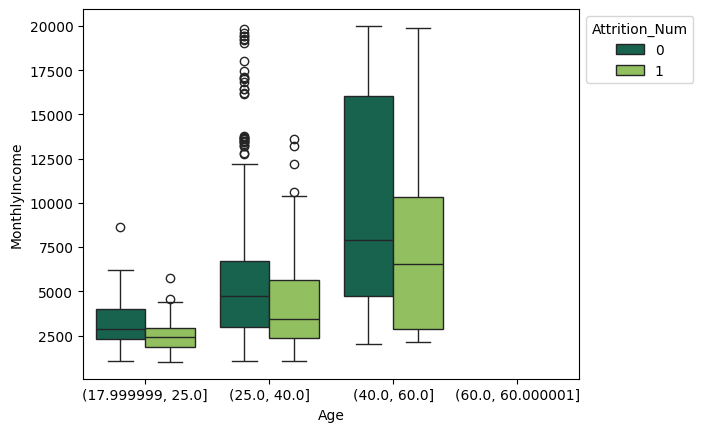

In [539]:
# Define the age bins
age_bins = [data["Age"].min() - 1e-6, 25, 40, 60, data["Age"].max() + 1e-6]
age_bins.sort()

# Set the colors
colors = ["#0c6f53", "#92d050"]

# Create the boxplot
BoxplotMarital = sns.boxplot(x=pd.cut(data['Age'], age_bins), y="MonthlyIncome", hue="Attrition_Num", data=data, palette=colors)

# Move the legend to the upper left
sns.move_legend(BoxplotMarital, "upper left", bbox_to_anchor=(1, 1))

# Show the plot
plt.show()

**__`3.3.`__ Statistical Exploration**

- Numerical Variables

<a id='exp'></stat>

In [540]:

numeric_data = data.select_dtypes(include=['number'])
skewness_kurtosis_df = pd.DataFrame({'Skewness': numeric_data.skew(), 'Kurtosis': numeric_data.kurt()})
skewness_kurtosis_df


,Skewness,Kurtosis
Age,0.413286,-0.404145
DailyRate,-0.003519,-1.203823
DistanceFromHome,0.958118,-0.224833
Education,-0.289681,-0.559115
EnvironmentSatisfaction,-0.321654,-1.202521
HourlyRate,-0.032311,-1.196398
JobInvolvement,-0.498419,0.270999
JobLevel,1.025401,0.399152
JobSatisfaction,-0.329672,-1.222193
MonthlyIncome,1.369817,1.005233


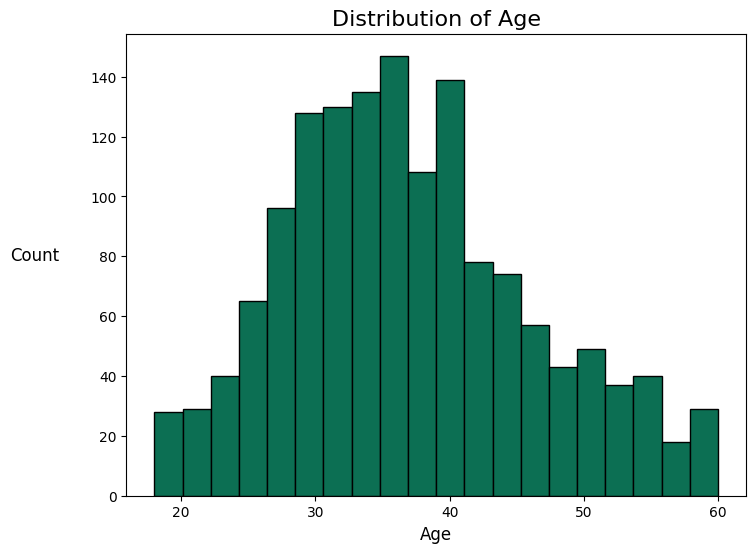

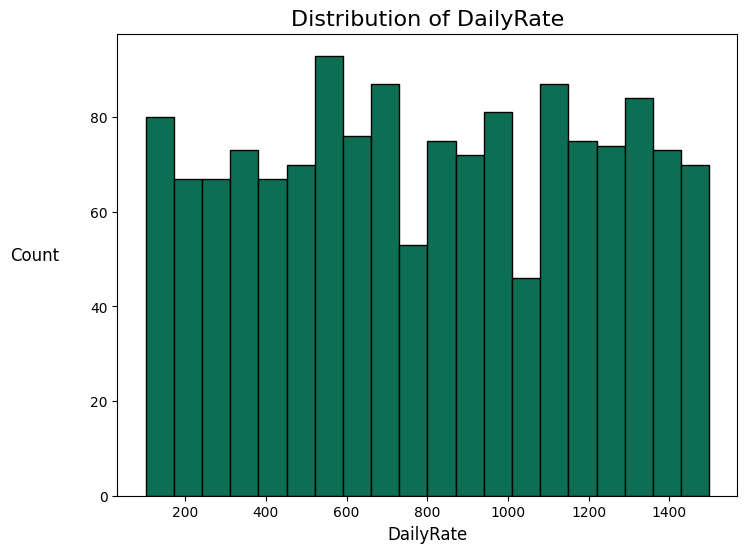

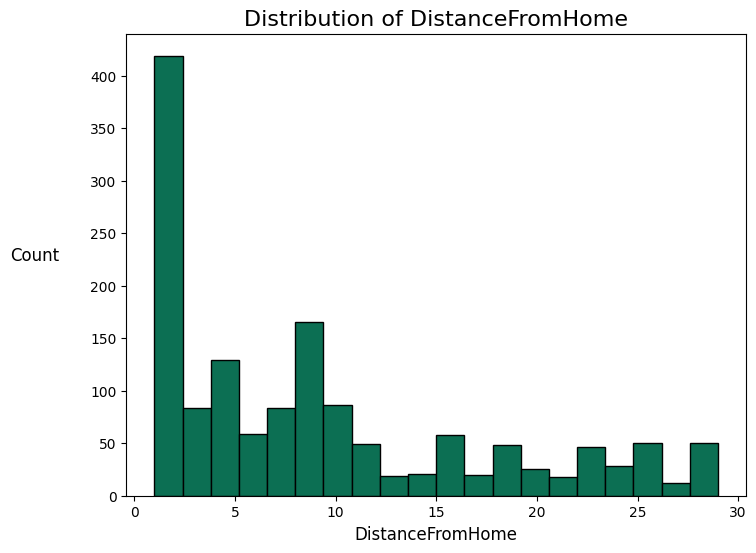

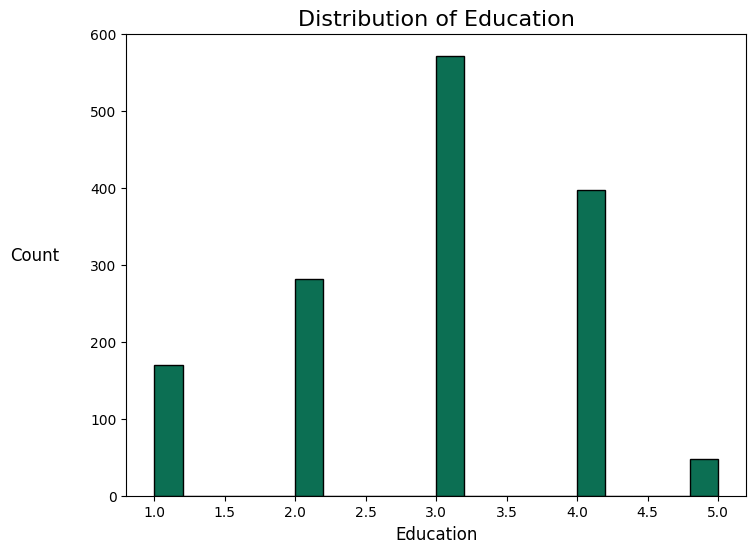

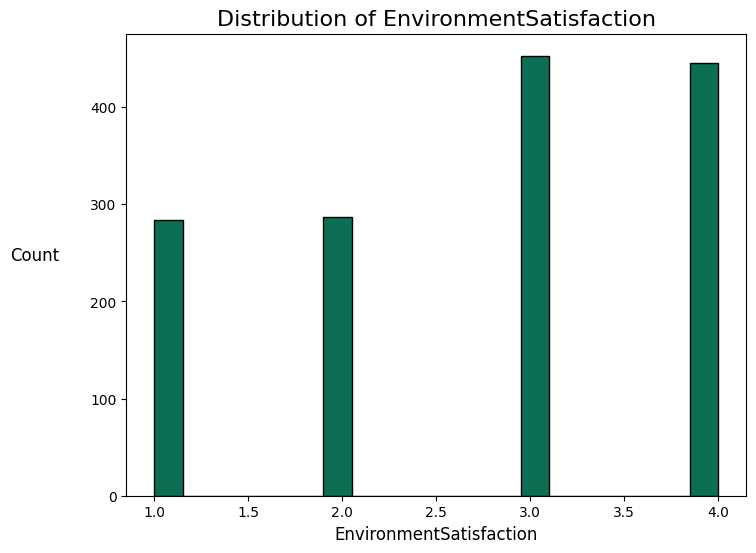

...

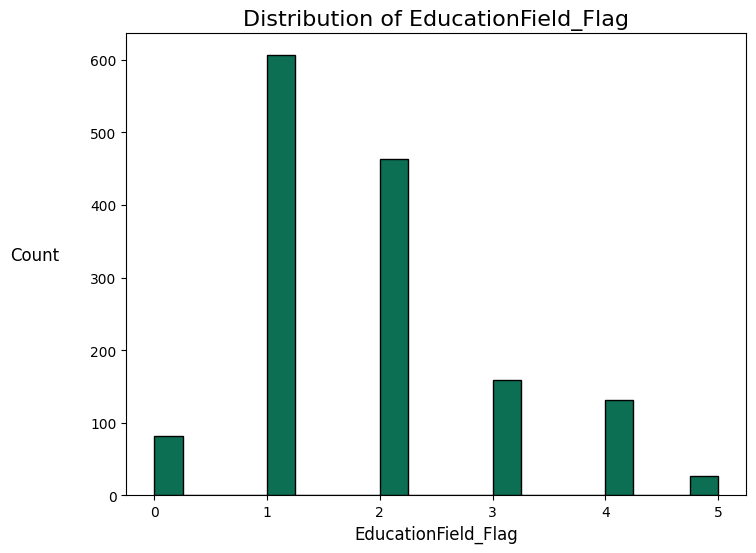

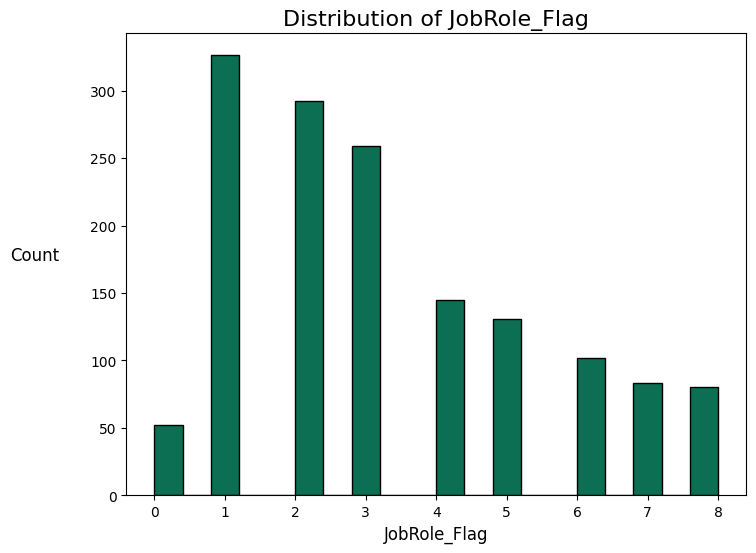

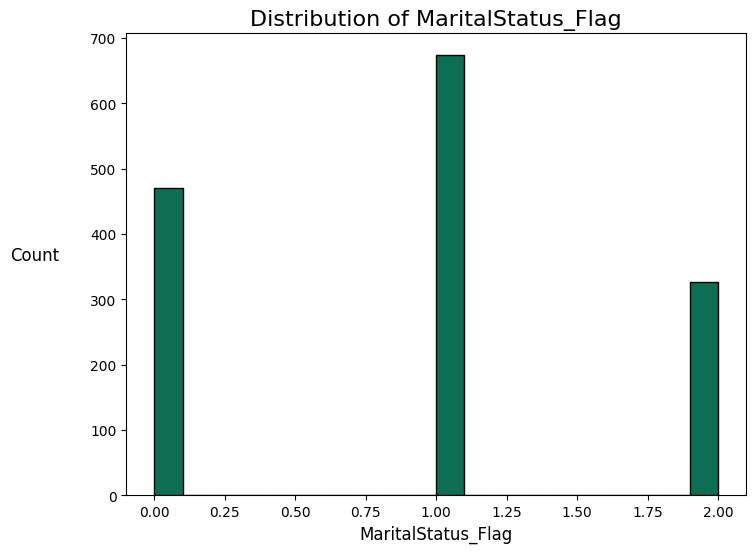

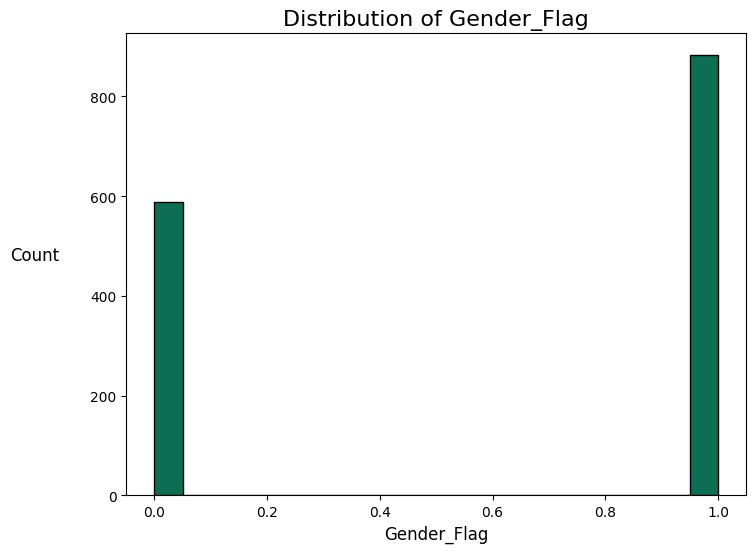

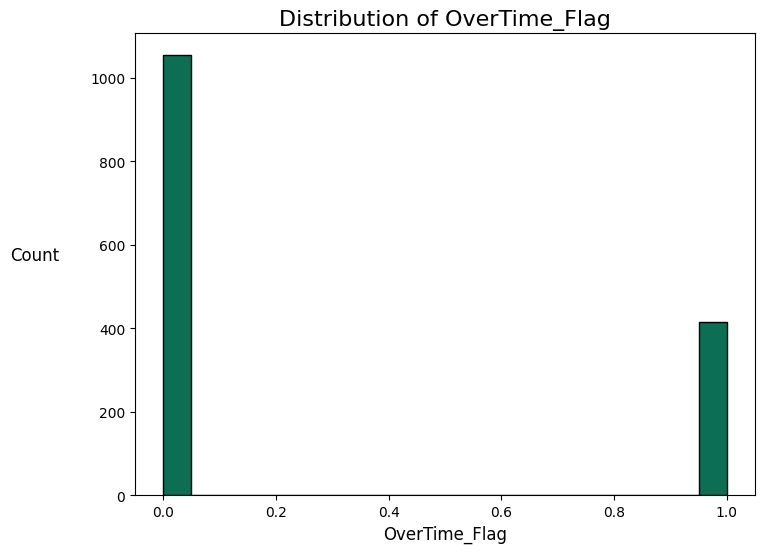

In [541]:

# Histogram of numerical variables
for column in numeric_data.columns:
    plt.figure(figsize=(8, 6))
    plt.hist(data[column], edgecolor='black', bins=20, color="#0c6f53")  # You can adjust the number of bins as needed
    plt.title(f'Distribution of {column}', fontsize=16)
    plt.xlabel(column, fontsize=12)
    plt.ylabel('Count', fontsize=12, rotation=0, labelpad=40)
    plt.show()



**__`3.4.`__ Correlation Matrix**

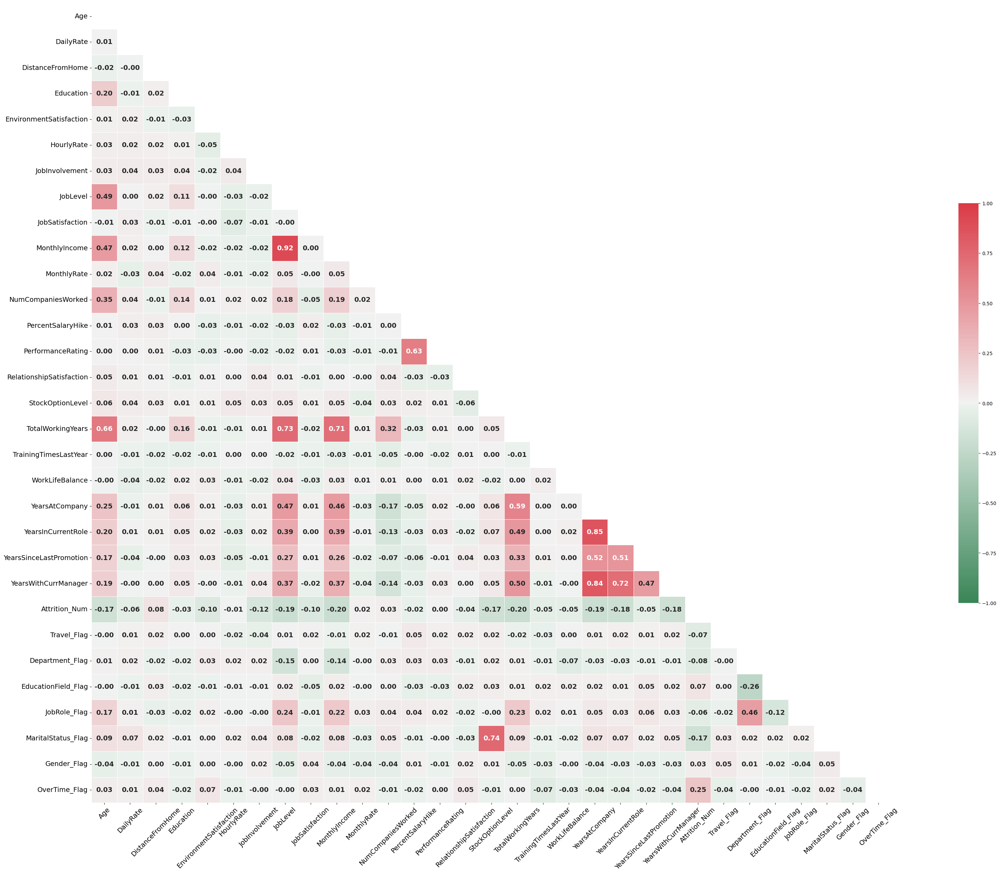

In [542]:
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt



df_corr = numeric_data.corr(method='spearman')

mask = np.triu(np.ones_like(df_corr, dtype=bool))

f, ax = plt.subplots(figsize=(50, 30))

# Use a simple green colormap
cmap = sns.diverging_palette(140, 10, as_cmap=True)

sns.heatmap(df_corr, mask=mask, cmap=cmap, center=0, vmin=-1, vmax=1,
            square=True, annot=True, fmt='0.2f', linewidths=.5, cbar_kws={"shrink": .5}, annot_kws={"fontweight": "bold", "fontsize": 14})

plt.xticks(fontsize=14, rotation=45)
plt.yticks(fontsize=14)

plt.show()




<div style="background-color: #92d050; color: white; padding: 10px;">
<a id='scrub'>
<h3 style="color: white;"><strong>4. Feature Selection</strong></h3>
</a>
</div>

Create a new instance of StratifiedKFold named as `skf`, with the following hyperparameters:
- n_splits = 5
- random_state = 99
- shuffle = True

In [543]:
categoricalVar = data.select_dtypes(include=['object']).columns.tolist()
numericalVar= data.select_dtypes(exclude=['object']).columns.tolist()

print("The numerical variables are: \n{}.".format((numericalVar)))
print("\nThe non-numerical variables are:\n{}.".format(categoricalVar))

print("\nIn summary:")
pd.DataFrame(([categoricalVar, numericalVar]),index = ['Categorical Variables', 'Numerical Variables']).T

The numerical variables are: 
['Age', 'DailyRate', 'DistanceFromHome', 'Education', 'EnvironmentSatisfaction', 'HourlyRate', 'JobInvolvement', 'JobLevel', 'JobSatisfaction', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked', 'PercentSalaryHike', 'PerformanceRating', 'RelationshipSatisfaction', 'StockOptionLevel', 'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance', 'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion', 'YearsWithCurrManager', 'Attrition_Num', 'Travel_Flag', 'Department_Flag', 'EducationField_Flag', 'JobRole_Flag', 'MaritalStatus_Flag', 'Gender_Flag', 'OverTime_Flag'].

The non-numerical variables are:
[].

In summary:


,Categorical Variables,Numerical Variables
0,None,Age
1,None,DailyRate
2,None,DistanceFromHome
3,None,Education
4,None,EnvironmentSatisfaction
5,None,HourlyRate
6,None,JobInvolvement
7,None,JobLevel
8,None,JobSatisfaction
9,None,MonthlyIncome


**__`4.1.1`__ Categorical Features**

<a id='dim'></a>

We are going to use chi-square to understand which categorical variables should we keep. <br>


**__`4.1.1.1`__ Chi-Square (Filter Method) - For categorical data**
</a>

In [544]:
X = data.drop('Attrition_Num', axis = 1)
y = data['Attrition_Num'].copy()

Dropping `Over18`, since they are irrelevant for feature selection


In [545]:
#Teste

`apply_chisquare` to select features from the categorical variables using `chi2_contigency`from `scipy.stats`.

In [546]:
def apply_chisquare(X,y,var,alpha=0.05):        
    dfObserved = pd.crosstab(y,X) 
    chi2, p, dof, expected = stats.chi2_contingency(dfObserved.values)
    dfExpected = pd.DataFrame(expected, columns=dfObserved.columns, index = dfObserved.index)
    if p<alpha:
        result="{0} is IMPORTANT for Prediction".format(var)
    else:
        result="{0} is NOT an important predictor. (Discard {0} from model)".format(var)
    print(result)

`select_best_cat_features` 

In [547]:
def select_best_cat_features(X, y):
    count = 1

    # Initialize StratifiedKFold
    skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

    for train_index, val_index in skf.split(X, y):
        X_train, X_val = X.iloc[train_index], X.iloc[val_index]
        y_train, y_val = y.iloc[train_index], y.iloc[val_index]

        print('_________________________________________________________________________________________________\n')
        print('                                     SPLIT ' + str(count) + '                                    ')
        print('_________________________________________________________________________________________________')

        # check which features to use using chi-square
        X_train_cat = X_train[['Travel_Flag', 'Department_Flag', 'Education', 'EducationField_Flag', 'Gender_Flag', 'JobRole_Flag', 'MaritalStatus_Flag', 'OverTime_Flag', 'StockOptionLevel']].copy()
        for var in X_train_cat:
            apply_chisquare(X_train_cat[var], y_train, var)

        count += 1

# Replace 'your_module' with the actual name of the module where apply_chisquare is defined
# The rest of your code remains the same.


In [548]:
data

,Age,DailyRate,DistanceFromHome,Education,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,JobSatisfaction,MonthlyIncome,...,YearsSinceLastPromotion,YearsWithCurrManager,Attrition_Num,Travel_Flag,Department_Flag,EducationField_Flag,JobRole_Flag,MaritalStatus_Flag,Gender_Flag,OverTime_Flag
EmployeeNumber,,,,,,,,,,,,,,,,,,,,,
1,41,1102,1,2,2,94,3,2,4,5993,...,0,5,1,0,1,1,1,0,0,1
2,49,279,8,1,3,61,2,2,2,5130,...,1,7,0,0,2,1,2,1,1,0
4,37,1373,2,2,4,92,2,1,3,2090,...,0,0,1,0,2,0,3,0,1,1
5,33,1392,3,4,4,56,3,1,3,2909,...,3,0,0,0,2,1,2,1,0,1
7,27,591,2,1,1,40,3,1,2,3468,...,2,2,0,0,2,2,3,1,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2061,36,884,23,2,3,41,4,2,4,2571,...,0,3,0,0,2,2,3,1,1,0
2062,39,613,6,1,4,42,2,3,1,9991,...,1,7,0,0,2,2,5,1,1,0
2064,27,155,4,3,2,87,4,2,2,6142,...,0,3,0,0,2,1,4,1,1,1


In [549]:
select_best_cat_features(X,y)

_________________________________________________________________________________________________

                                     SPLIT 1                                    
_________________________________________________________________________________________________
Travel_Flag is IMPORTANT for Prediction
Department_Flag is IMPORTANT for Prediction
Education is NOT an important predictor. (Discard Education from model)
EducationField_Flag is IMPORTANT for Prediction
Gender_Flag is NOT an important predictor. (Discard Gender_Flag from model)
JobRole_Flag is IMPORTANT for Prediction
MaritalStatus_Flag is IMPORTANT for Prediction
OverTime_Flag is IMPORTANT for Prediction
StockOptionLevel is IMPORTANT for Prediction
_________________________________________________________________________________________________

                                     SPLIT 2                                    
_______________________________________________________________________________________

What can we conclude?

We should remove Gender and Educaiton fO SURE.m

**__`4.1.2`__ Numerical Features**

In [550]:
def apply_variance(X_train):
    print(X_train.var())

In [551]:
def select_features_variance(X,y):
    count = 1
    for train_index, val_index in skf.split(X,y):
        X_train, X_val = X.iloc[train_index], X.iloc[val_index]
        y_train, y_val = y.iloc[train_index], y.iloc[val_index]

        ######################################### SELECT FEATURES #################################################        
        print('_________________________________________________________________________________________________\n')
        print('                                     SPLIT ' + str(count) + '                                    ')
        print('_________________________________________________________________________________________________')

        # check which features to use using variance
        apply_variance(X_train)
            
        count+=1

In [552]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1470 entries, 1 to 2068
Data columns (total 31 columns):
 #   Column                    Non-Null Count  Dtype
---  ------                    --------------  -----
 0   Age                       1470 non-null   int64
 1   DailyRate                 1470 non-null   int64
 2   DistanceFromHome          1470 non-null   int64
 3   Education                 1470 non-null   int64
 4   EnvironmentSatisfaction   1470 non-null   int64
 5   HourlyRate                1470 non-null   int64
 6   JobInvolvement            1470 non-null   int64
 7   JobLevel                  1470 non-null   int64
 8   JobSatisfaction           1470 non-null   int64
 9   MonthlyIncome             1470 non-null   int64
 10  MonthlyRate               1470 non-null   int64
 11  NumCompaniesWorked        1470 non-null   int64
 12  PercentSalaryHike         1470 non-null   int64
 13  PerformanceRating         1470 non-null   int64
 14  RelationshipSatisfaction  1470 non-null   int

In [553]:
def apply_variance(X_train):
    print(X_train.var())

In [554]:
def select_features_variance(X,y):
    count = 1
    for train_index, val_index in skf.split(X,y):
        X_train, X_val = X.iloc[train_index], X.iloc[val_index]
        y_train, y_val = y.iloc[train_index], y.iloc[val_index]

        ######################################### SELECT FEATURES #################################################        
        print('_________________________________________________________________________________________________\n')
        print('                                     SPLIT ' + str(count) + '                                    ')
        print('_________________________________________________________________________________________________')

        # check which features to use using variance
        apply_variance(X_train)
            
        count+=1

In [555]:

skf = StratifiedKFold(n_splits = 5, random_state = 99, shuffle = True)

In [556]:
select_features_variance(X,y)

_________________________________________________________________________________________________

                                     SPLIT 1                                    
_________________________________________________________________________________________________
Age                         8.542577e+01
DailyRate                   1.630649e+05
DistanceFromHome            6.529640e+01
Education                   1.050976e+00
EnvironmentSatisfaction     1.219349e+00
HourlyRate                  4.076624e+02
JobInvolvement              5.056680e-01
JobLevel                    1.268768e+00
JobSatisfaction             1.201251e+00
MonthlyIncome               2.303965e+07
MonthlyRate                 5.080834e+07
NumCompaniesWorked          6.148617e+00
PercentSalaryHike           1.323087e+01
PerformanceRating           1.243704e-01
RelationshipSatisfaction    1.149805e+00
StockOptionLevel            7.268085e-01
TotalWorkingYears           6.296801e+01
TrainingTimesLastYear    

**__`4.1.3`__ Spearman**

We can use Spearman correlation to determine if we have redundant variables that should be removed due to their high correlation.

In [557]:
def cor_heatmap(cor):
    plt.figure(figsize=(9, 6))
    
    # Define your light and dark greens
    light_green = "#92d050"
    dark_green = "#0c6f53"
    
    # Create a custom diverging color palette with a gradient
    cmap = sns.blend_palette([light_green, dark_green], as_cmap=True)
    
    sns.heatmap(data=cor, annot=True, cmap=cmap, fmt='.2f', linewidths=.5, cbar_kws={"shrink": .5}, annot_kws={"fontweight": "bold", "fontsize": 10})
    
    plt.show()


In [558]:
def apply_correlation(X_train):
    correlation_data = X_train
    matrix = correlation_data.corr(method = 'spearman')
    cor_heatmap(matrix)

In [559]:
def redundant_features(X,y):
    count = 1
    for train_index, val_index in skf.split(X,y):
        X_train, X_val = X.iloc[train_index], X.iloc[val_index]
        y_train, y_val = y.iloc[train_index], y.iloc[val_index]

        ######################################### SELECT FEATURES #################################################        
        print('_________________________________________________________________________________________________\n')
        print('                                     SPLIT ' + str(count) + '                                    ')
        print('_________________________________________________________________________________________________')
        
        # check which features to use using spearman correlation
        apply_correlation(X_train)
        
        count+=1

_________________________________________________________________________________________________

                                     SPLIT 1                                    
_________________________________________________________________________________________________


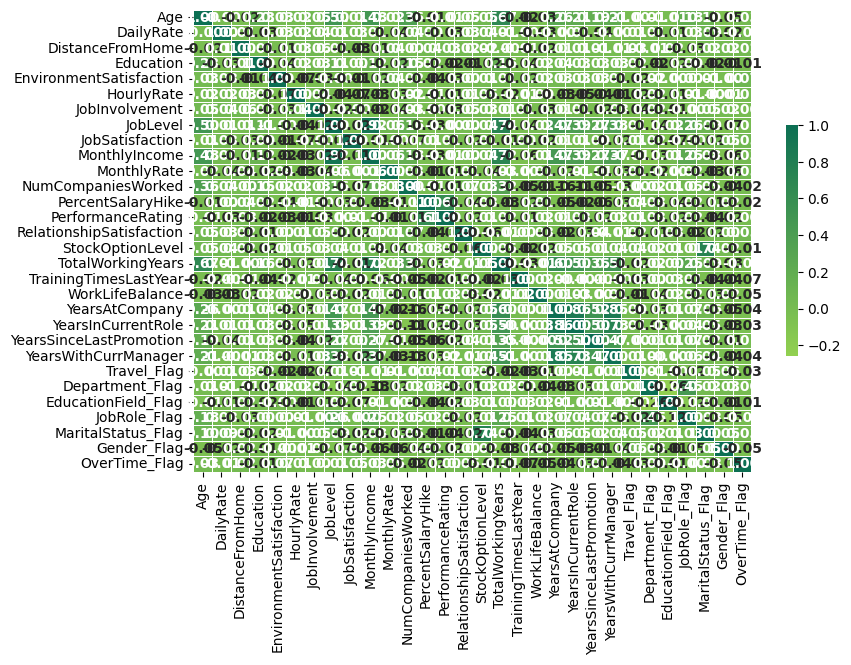

_________________________________________________________________________________________________

                                     SPLIT 2                                    
_________________________________________________________________________________________________


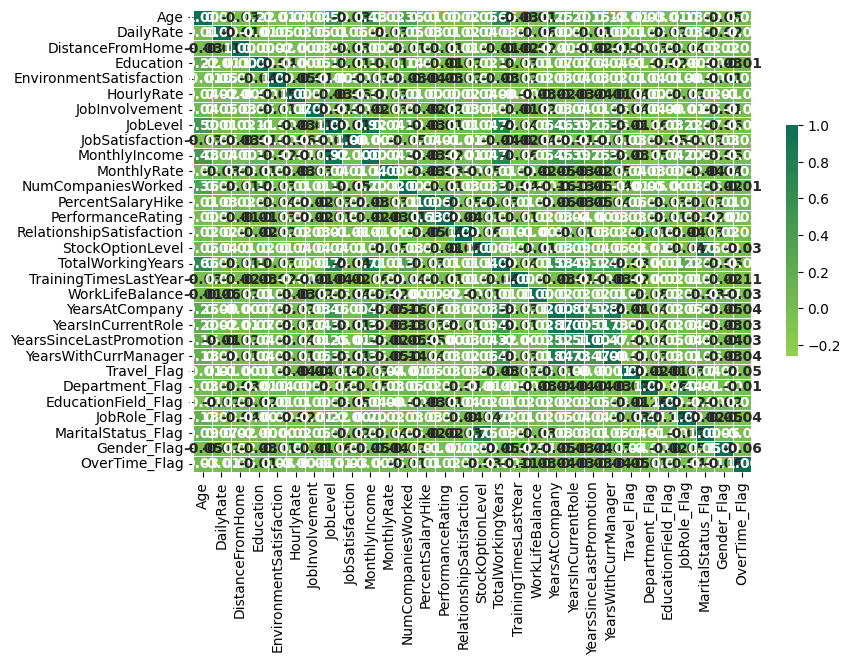

_________________________________________________________________________________________________

                                     SPLIT 3                                    
_________________________________________________________________________________________________


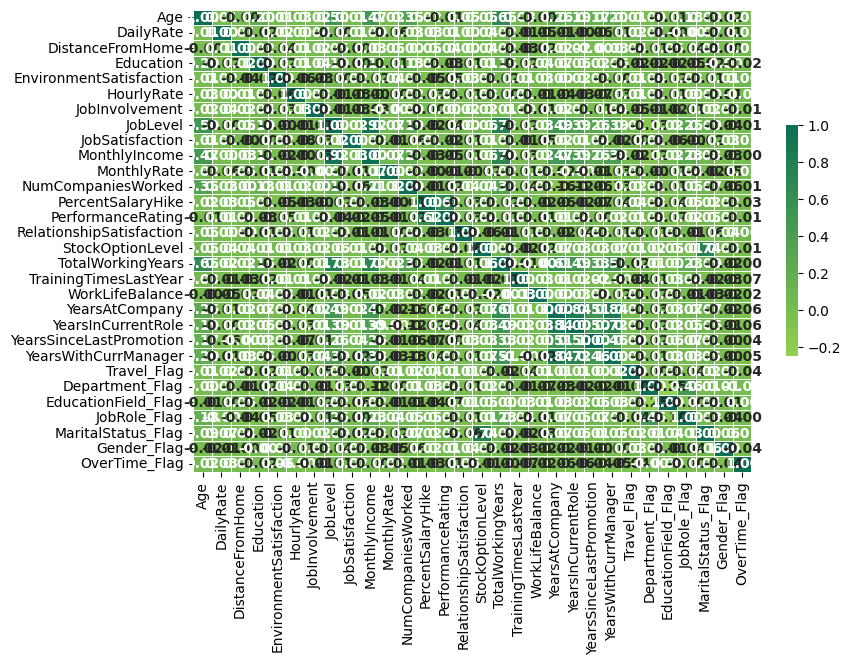

_________________________________________________________________________________________________

                                     SPLIT 4                                    
_________________________________________________________________________________________________


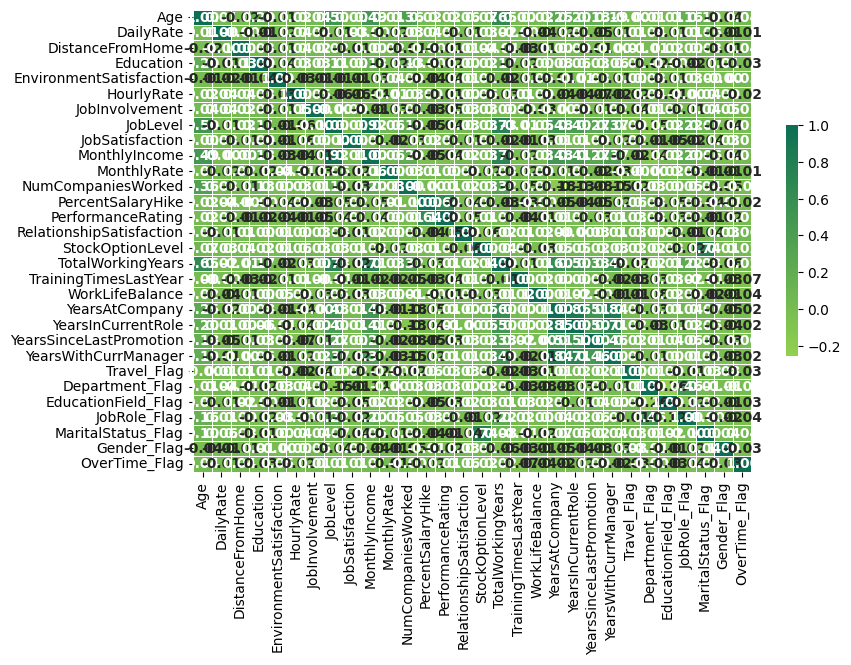

_________________________________________________________________________________________________

                                     SPLIT 5                                    
_________________________________________________________________________________________________


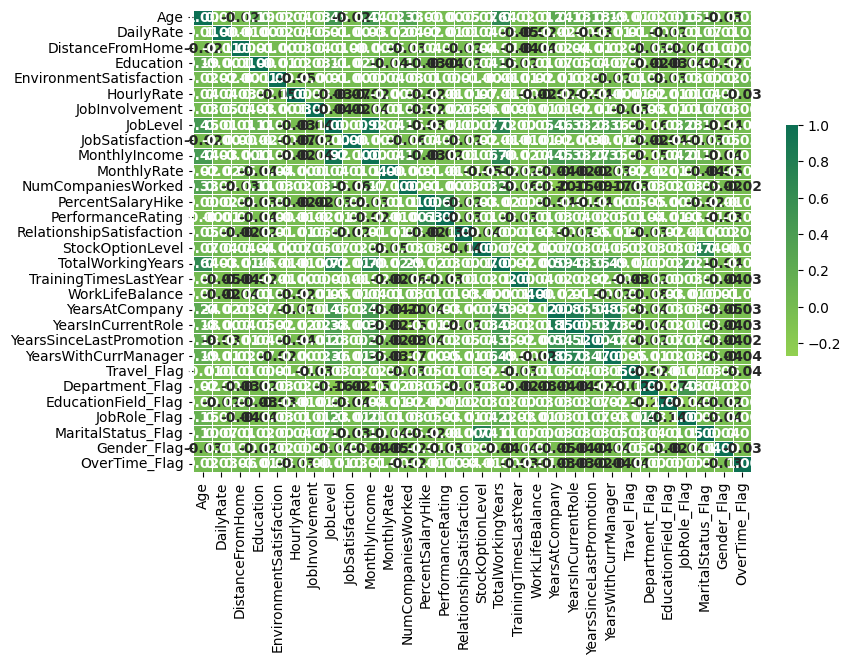

In [560]:
redundant_features(X, y)


Now it is time to understand the ones that we should keep and the ones to be removed. <br>

The remaining methods that we are going to apply  for feature selection are: 
- __Wrapper methods__ - RFE
- __Embedded Methods__ - Lasso Regression and Decision Trees

It is important to note that regression models are particularly sensible to correlated features. Therefore, we will begin by applying decision trees to identify which features among the correlated ones should be excluded. 

Once we have eliminated the correlated features, we can proceed with techniques that involve regression models, such as RFE (using Logistic Regression) and Lasso Regression.

**__`4.1.4`__ Decision Trees**


In [561]:
def plot_importance(variables, name):
    # Sort the variables by importance
    imp_features = variables.sort_values()

    plt.figure(figsize=(8, 6))

    # Use your specific dark green color
    dark_green = "#0c6f53"
    imp_features.plot(kind="barh", color=dark_green)

    plt.title("Feature importance using " + name + " Model")
    plt.xlabel("Importance")
    plt.ylabel("Features")
    plt.show()

In [562]:
def apply_dt(X_train, y_train):
    dt = DecisionTreeClassifier(random_state = 99).fit(X_train, y_train)
    feature_importances = pd.Series(dt.feature_importances_, index = X_train.columns)
    plot_importance(feature_importances, 'DT')

In [563]:
def select_best_features_dt(X, y):
    count = 1
    for train_index, val_index in skf.split(X,y):
        X_train, X_val = X.iloc[train_index], X.iloc[val_index]
        y_train, y_val = y.iloc[train_index], y.iloc[val_index]

        ######################################### SELECT FEATURES #################################################        
        print('_________________________________________________________________________________________________\n')
        print('                                     SPLIT ' + str(count) + '                                    ')
        print('_________________________________________________________________________________________________')

        # check which features to use using decision Tree
       
        apply_dt(X_train, y_train)
        
        count+=1

_________________________________________________________________________________________________

                                     SPLIT 1                                    
_________________________________________________________________________________________________


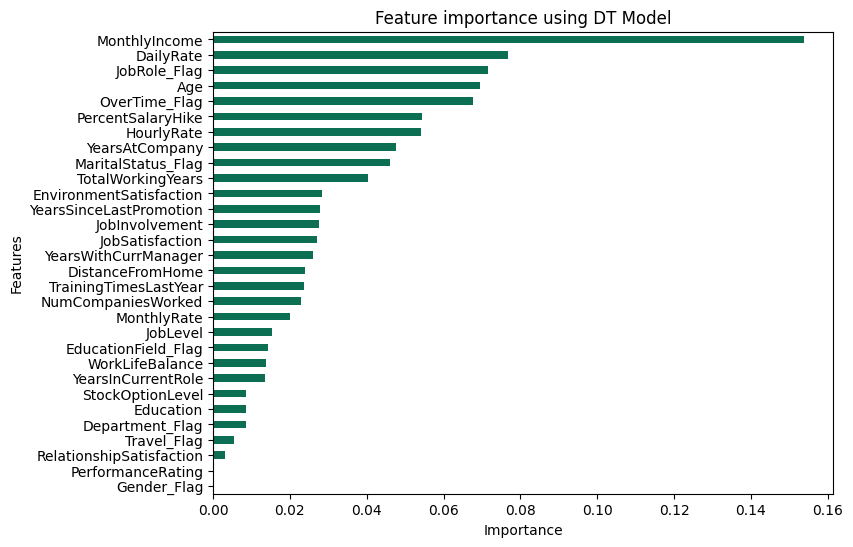

_________________________________________________________________________________________________

                                     SPLIT 2                                    
_________________________________________________________________________________________________


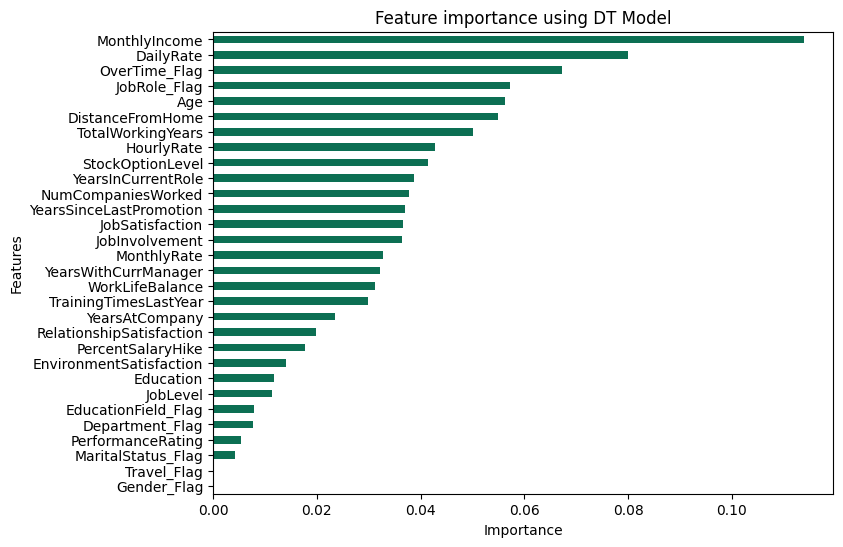

_________________________________________________________________________________________________

                                     SPLIT 3                                    
_________________________________________________________________________________________________


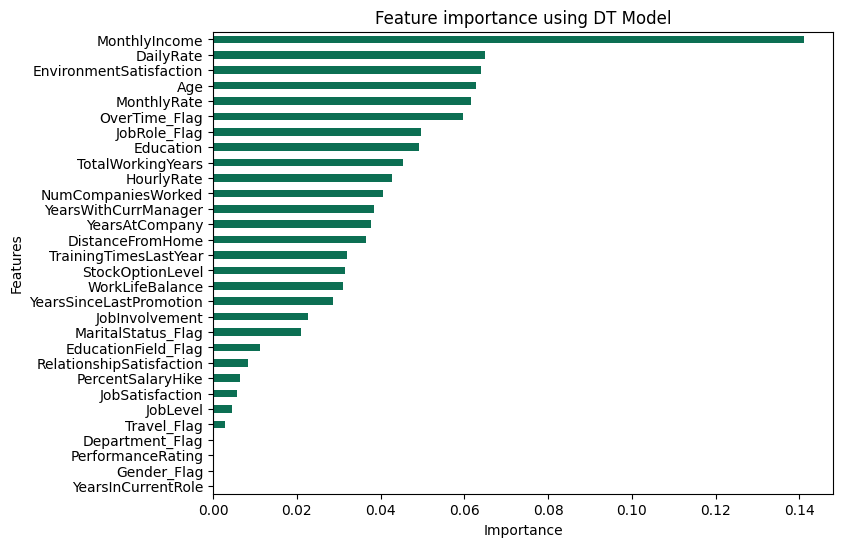

_________________________________________________________________________________________________

                                     SPLIT 4                                    
_________________________________________________________________________________________________


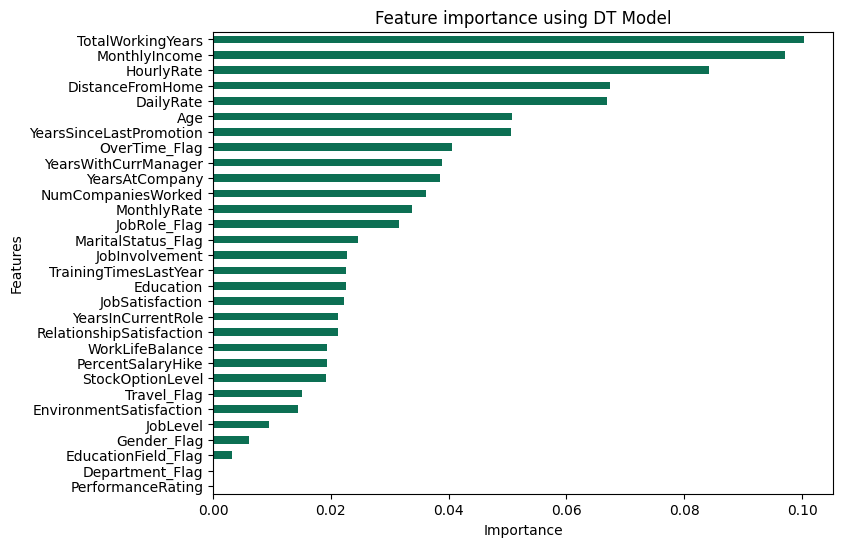

_________________________________________________________________________________________________

                                     SPLIT 5                                    
_________________________________________________________________________________________________


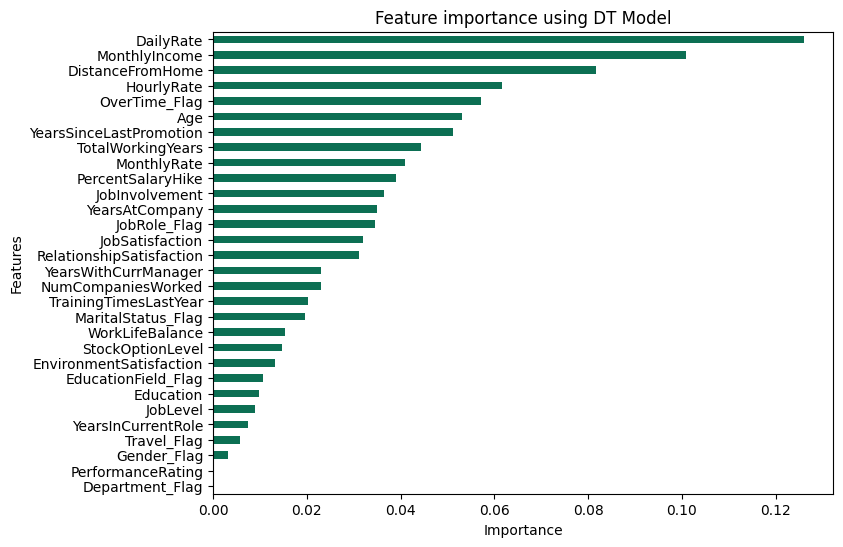

In [564]:
select_best_features_dt(X, y)

We had identified previously with correlation matrix that two groups of variables that seem to be highly correlated among them, namely:
- JobLevel, MonthlyIncome
- YearsAtCompany, YearsInCurrentRole, YearsWithCurrManager

From the first group, we are going to include only MonthlyIncome, the variable that according to decision trees feature importance appears five times as one the most important. We remove `JobLevel`.

From the second group, we are going to keep YearsWithCurrentManger, that appears always more important than YearsinCurrentRole and the other one. 

Not sure ---

In [565]:
X = X.drop(['JobLevel','YearsAtCompany','YearsInCurrentRole'], axis = 1)

**__`4.1.5`__ RFE, LASSO and DT**


In [566]:
def plot_importance(variables, name):
    # Sort the variables by importance
    imp_features = variables.sort_values()

    plt.figure(figsize=(8, 6))

    # Use your specific dark green color
    dark_green = "#0c6f53"
    imp_features.plot(kind="barh", color=dark_green)

    plt.title("Feature importance using " + name + " Model")
    plt.xlabel("Importance")
    plt.ylabel("Features")
    plt.show()

In [567]:
def apply_lasso(X_train, y_train):
    lasso = LassoCV().fit(X_train, y_train)
    coef = pd.Series(lasso.coef_, index = X_train.columns)
    plot_importance(coef,'Lasso')

In [568]:
def select_best_features(X,y):
    count = 1
    for train_index, val_index in skf.split(X,y):
        X_train, X_val = X.iloc[train_index], X.iloc[val_index]
        y_train, y_val = y.iloc[train_index], y.iloc[val_index]

        ########################################### SCALE DATA #################################################### 
        numerical_data = X_train.drop(['Travel_Flag','Department_Flag','Education', 'EducationField_Flag', 'Gender_Flag', 'JobRole_Flag', 'MaritalStatus_Flag', 'OverTime_Flag', 'StockOptionLevel'], axis = 1).copy()
        scaler = MinMaxScaler().fit(numerical_data)
        X_train_scaled = scaler.transform(numerical_data)
        X_train_scaled = pd.DataFrame(X_train_scaled, columns = numerical_data.columns)
    
        ######################################### SELECT FEATURES #################################################        
        print('_________________________________________________________________________________________________\n')
        print('                                     SPLIT ' + str(count) + '                                    ')
        print('_________________________________________________________________________________________________')
        
  # Check which features to use using RFE
        print('')
        print('----------------- RFE ----------------------')
        apply_rfe(X_train_scaled, y_train)
        
        # check which features to use using lasso
        print('')
        print('----------------- LASSO ----------------------')
        apply_lasso(X_train_scaled, y_train)
            
        # check which features to use using DT
        print('')
        print('----------------- DT ----------------------')
        apply_dt(X_train_scaled, y_train)
            
        count+=1

_________________________________________________________________________________________________

                                     SPLIT 1                                    
_________________________________________________________________________________________________

----------------- RFE ----------------------
Age                          True
DailyRate                   False
DistanceFromHome            False
EnvironmentSatisfaction     False
HourlyRate                  False
JobInvolvement               True
JobSatisfaction             False
MonthlyIncome                True
MonthlyRate                 False
NumCompaniesWorked          False
PercentSalaryHike           False
PerformanceRating           False
RelationshipSatisfaction    False
TotalWorkingYears           False
TrainingTimesLastYear       False
WorkLifeBalance             False
YearsSinceLastPromotion      True
YearsWithCurrManager         True
dtype: bool

----------------- LASSO ----------------------


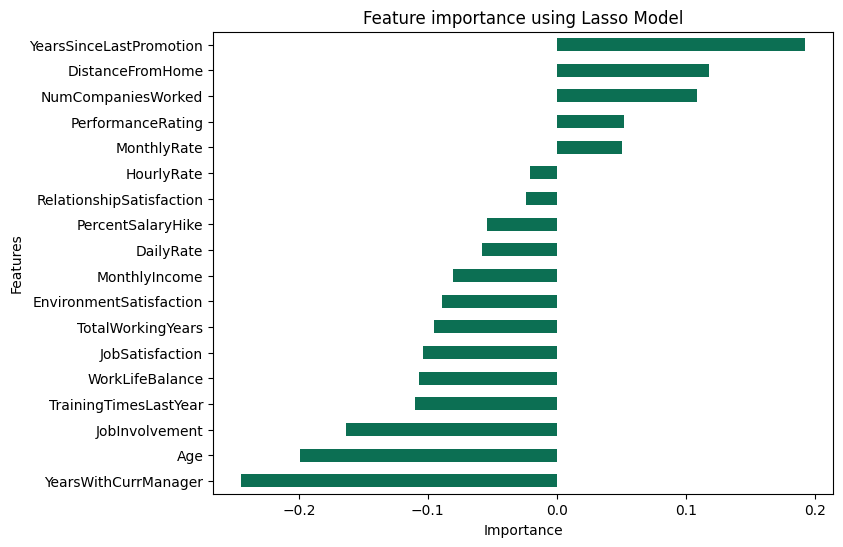


----------------- DT ----------------------


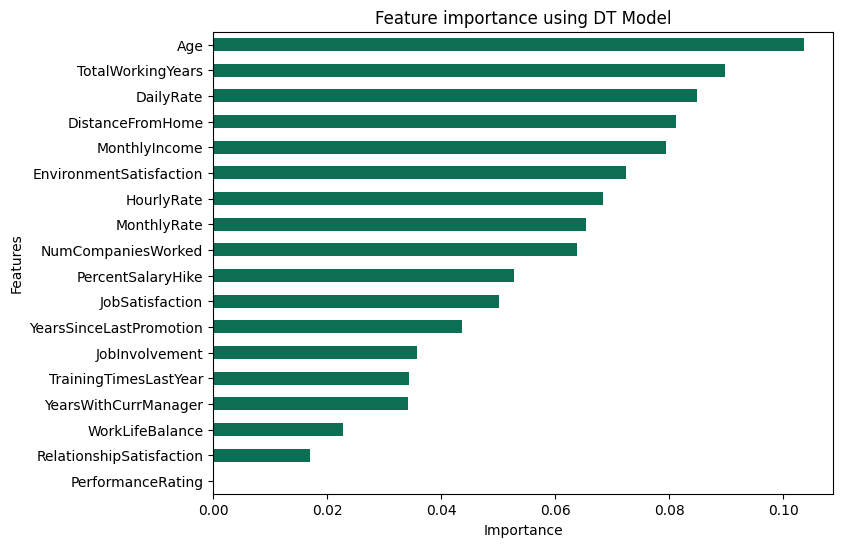

_________________________________________________________________________________________________

                                     SPLIT 2                                    
_________________________________________________________________________________________________

----------------- RFE ----------------------
Age                          True
DailyRate                   False
DistanceFromHome            False
EnvironmentSatisfaction     False
HourlyRate                  False
JobInvolvement               True
JobSatisfaction             False
MonthlyIncome               False
MonthlyRate                 False
NumCompaniesWorked          False
PercentSalaryHike           False
PerformanceRating           False
RelationshipSatisfaction    False
TotalWorkingYears            True
TrainingTimesLastYear       False
WorkLifeBalance             False
YearsSinceLastPromotion      True
YearsWithCurrManager         True
dtype: bool

----------------- LASSO ----------------------


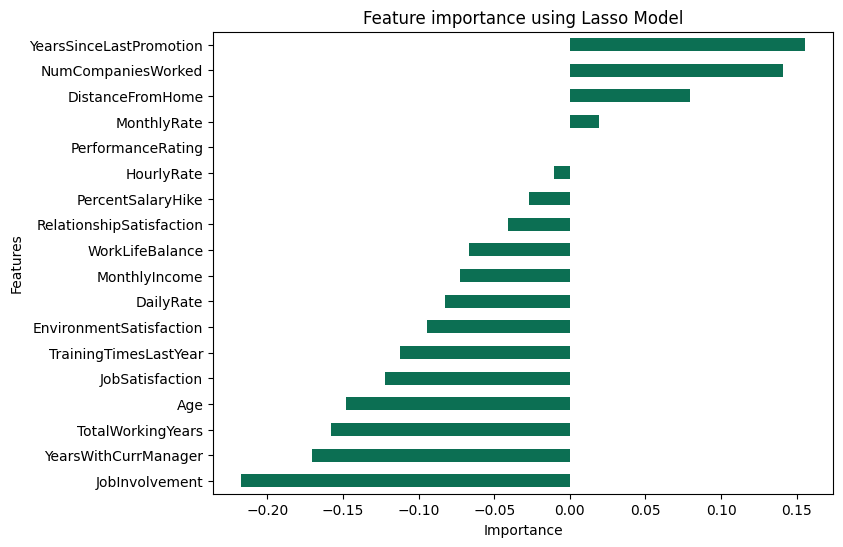


----------------- DT ----------------------


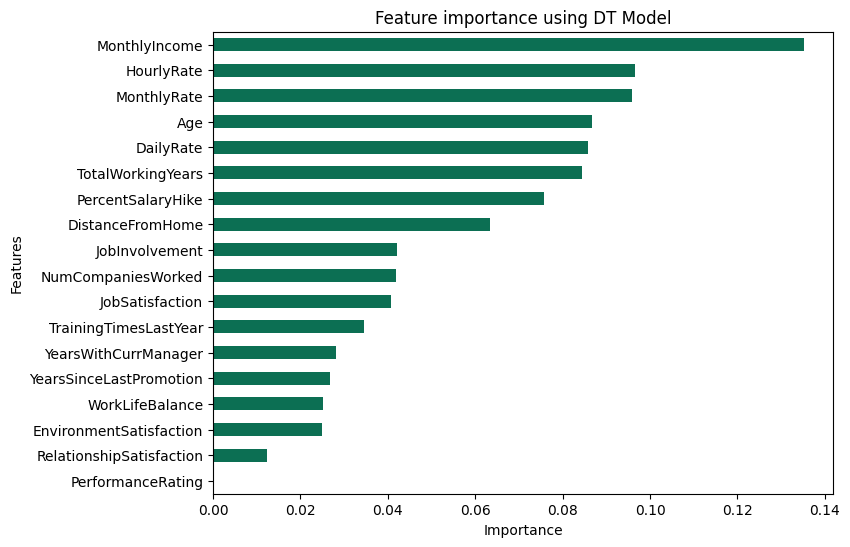

_________________________________________________________________________________________________

                                     SPLIT 3                                    
_________________________________________________________________________________________________

----------------- RFE ----------------------
Age                          True
DailyRate                   False
DistanceFromHome            False
EnvironmentSatisfaction      True
HourlyRate                  False
JobInvolvement               True
JobSatisfaction             False
MonthlyIncome                True
MonthlyRate                 False
NumCompaniesWorked          False
PercentSalaryHike           False
PerformanceRating           False
RelationshipSatisfaction    False
TotalWorkingYears           False
TrainingTimesLastYear       False
WorkLifeBalance             False
YearsSinceLastPromotion     False
YearsWithCurrManager         True
dtype: bool

----------------- LASSO ----------------------


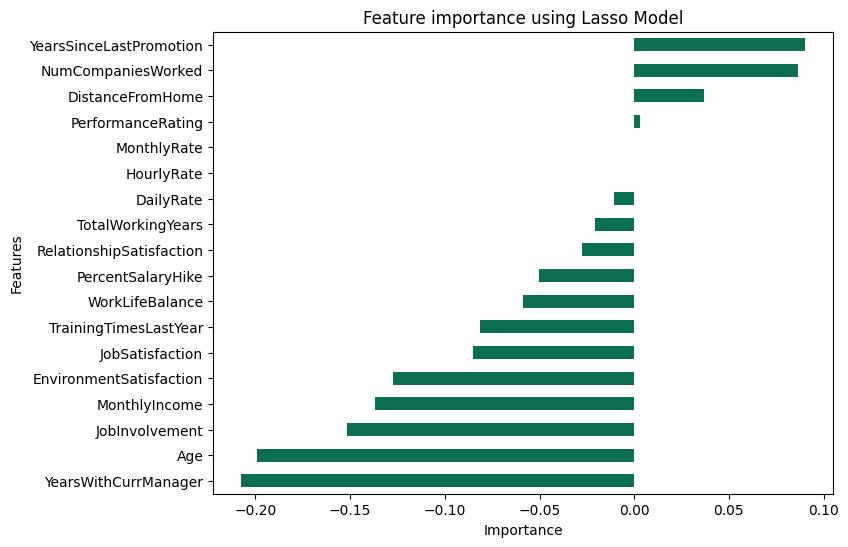


----------------- DT ----------------------


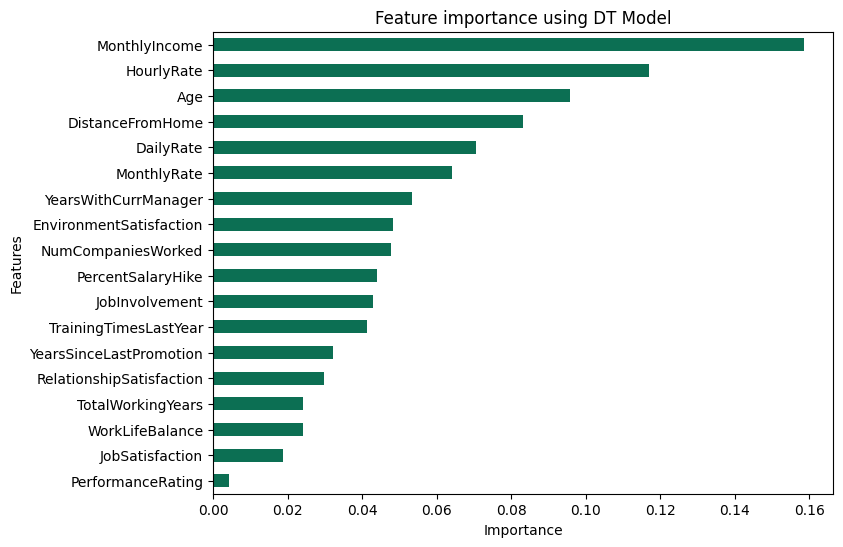

_________________________________________________________________________________________________

                                     SPLIT 4                                    
_________________________________________________________________________________________________

----------------- RFE ----------------------
Age                         False
DailyRate                   False
DistanceFromHome            False
EnvironmentSatisfaction     False
HourlyRate                  False
JobInvolvement               True
JobSatisfaction             False
MonthlyIncome                True
MonthlyRate                 False
NumCompaniesWorked          False
PercentSalaryHike           False
PerformanceRating           False
RelationshipSatisfaction    False
TotalWorkingYears            True
TrainingTimesLastYear       False
WorkLifeBalance             False
YearsSinceLastPromotion      True
YearsWithCurrManager         True
dtype: bool

----------------- LASSO ----------------------


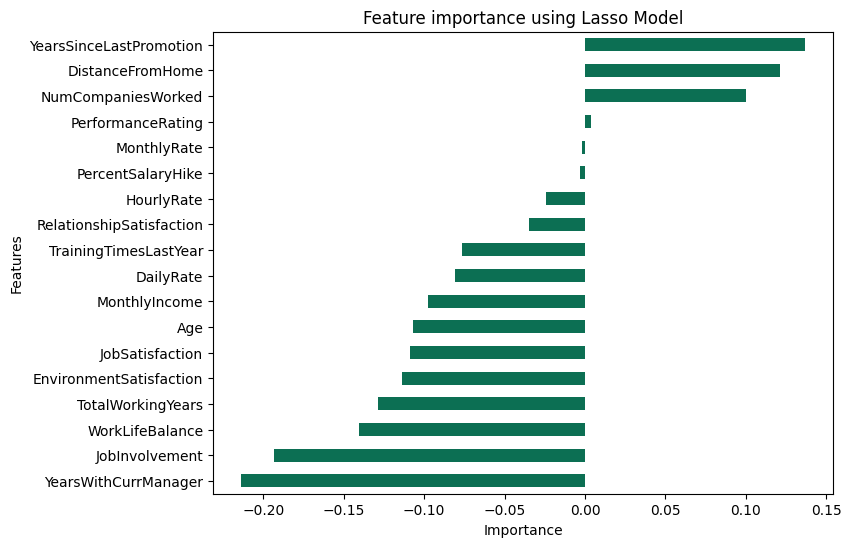


----------------- DT ----------------------


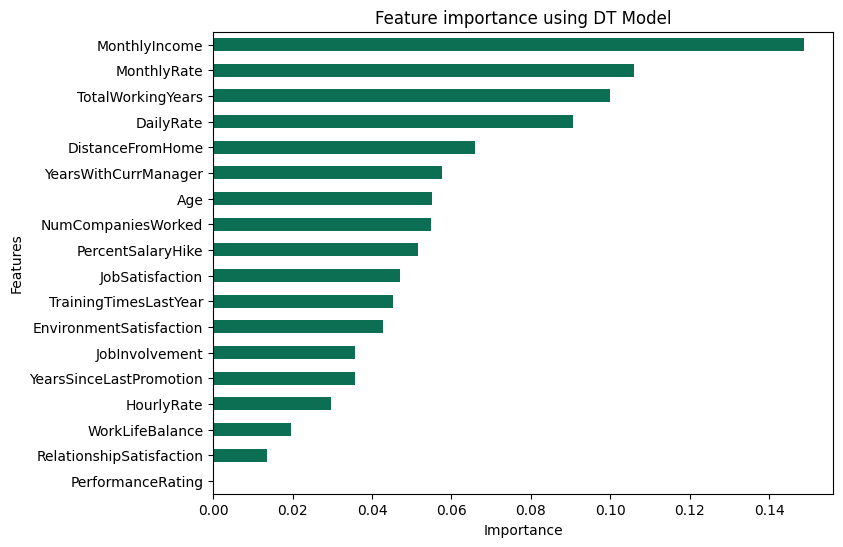

_________________________________________________________________________________________________

                                     SPLIT 5                                    
_________________________________________________________________________________________________

----------------- RFE ----------------------
Age                          True
DailyRate                   False
DistanceFromHome            False
EnvironmentSatisfaction     False
HourlyRate                  False
JobInvolvement               True
JobSatisfaction             False
MonthlyIncome                True
MonthlyRate                 False
NumCompaniesWorked          False
PercentSalaryHike           False
PerformanceRating           False
RelationshipSatisfaction    False
TotalWorkingYears           False
TrainingTimesLastYear       False
WorkLifeBalance             False
YearsSinceLastPromotion      True
YearsWithCurrManager         True
dtype: bool

----------------- LASSO ----------------------


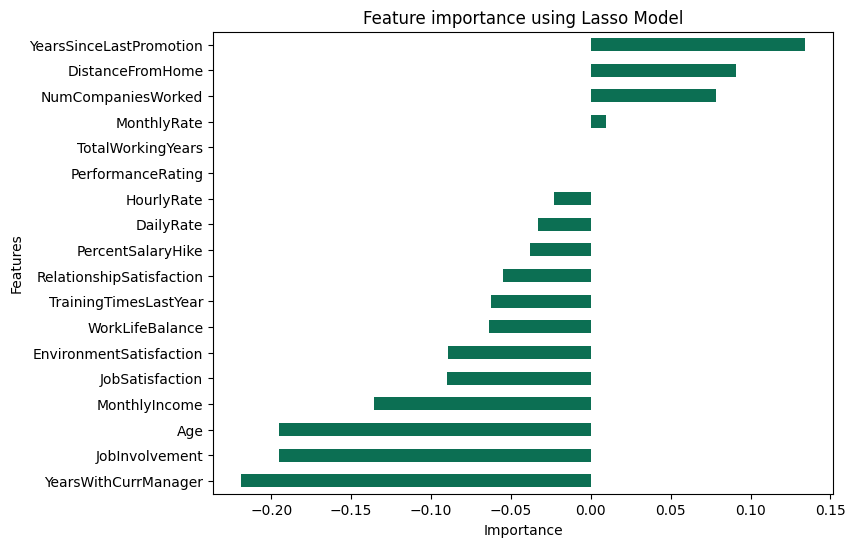


----------------- DT ----------------------


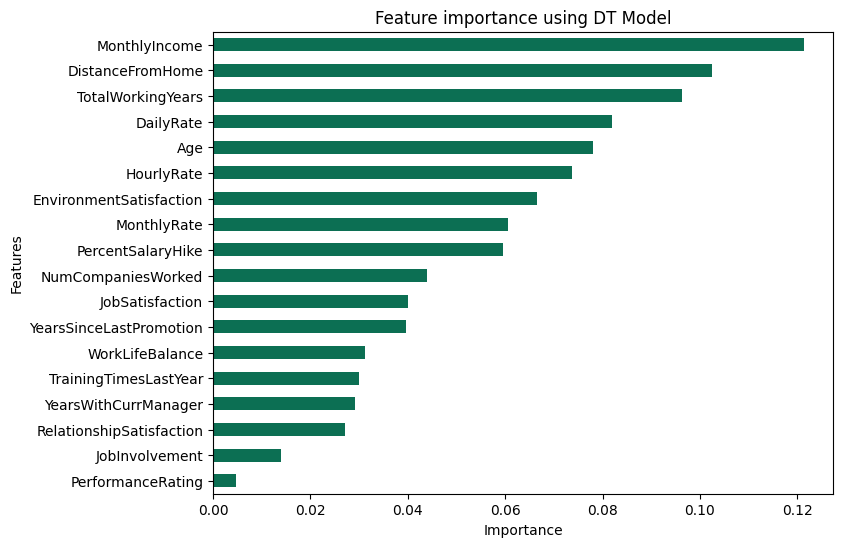

In [569]:
select_best_features(X, y)

<div style="background-color: #92d050; color: white; padding: 10px;">
<a id='scrub'>
<h3 style="color: white;"><strong>5. Modelling </strong></h3>
</a>
</div>

**__`5.1`__ Datasets Considered**

**Data:** Original dataset
**data_for_model:** Only 6 features - Major contributor features  
**data_for_model_2:** 12 most important features scaled 0 to 10  
**data_for_model_3:** 12 most important features scaled 0 to 1  
**data_for_model_4:** 6 most important features scaled 0 to 1  

Transformations follow below:


In [570]:
data_for_model = data.copy()

In [571]:
data_for_model = data_for_model[['Attrition_Num','MonthlyIncome', 'DistanceFromHome', 'Age', 'YearsWithCurrManager', 'Travel_Flag']]


In [572]:
data_for_model_2 = data[['Age', 'MonthlyIncome', 'YearsWithCurrManager', 'DistanceFromHome', 'JobInvolvement', 'YearsSinceLastPromotion', 'Travel_Flag', 'MaritalStatus_Flag','DailyRate','OverTime_Flag','StockOptionLevel', 'Attrition_Num']]

In [573]:
scaler = MinMaxScaler(feature_range=(0, 10))
data_for_model_2[['MonthlyIncome']] = scaler.fit_transform(data_for_model_2[['MonthlyIncome']])
data_for_model_2[['DailyRate']] = scaler.fit_transform(data_for_model_2[['DailyRate']])
data_for_model_2[['Age']] = scaler.fit_transform(data_for_model_2[['Age']])
data_for_model_2[['DistanceFromHome']] = scaler.fit_transform(data_for_model_2[['DistanceFromHome']])

In [574]:
data_for_model_3 = data_for_model_2.copy()

# Extract columns with "flag" in their names
flag_columns = [col for col in data_for_model_3.columns if 'flag' in col.lower()]

# Columns to exclude from scaling
exclude_columns = ['StockOptionLevel']

# Create a MinMaxScaler
scaler = MinMaxScaler()

# Scale all columns in data_for_model_3 excluding those with "flag" in their names and the specified exclude_columns
columns_to_scale = [col for col in data_for_model_3.columns if col not in flag_columns and col not in exclude_columns]
data_for_model_3[columns_to_scale] = scaler.fit_transform(data_for_model_3[columns_to_scale])



In [575]:
data_for_model_4 = data_for_model.copy()

# Extract columns with "flag" in their names
flag_columns = [col for col in data_for_model_4.columns if 'flag' in col.lower()]

# Columns to exclude from scaling
exclude_columns = ['StockOptionLevel']

# Create a MinMaxScaler
scaler = MinMaxScaler()

# Scale all columns in data_for_model_3 excluding those with "flag" in their names and the specified exclude_columns
columns_to_scale = [col for col in data_for_model_4.columns if col not in flag_columns and col not in exclude_columns]
data_for_model_4[columns_to_scale] = scaler.fit_transform(data_for_model_4[columns_to_scale])



**__`5.2`__ Logistic Regression**

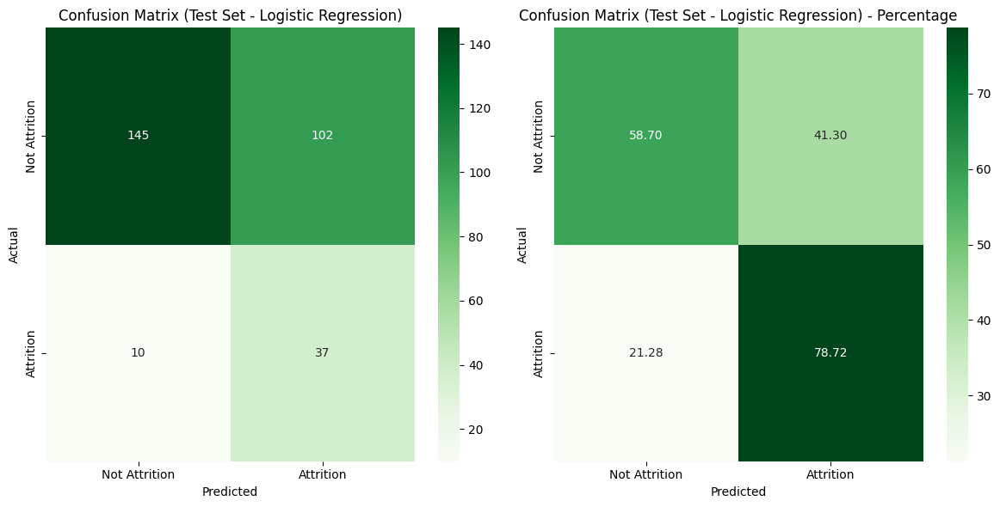

Accuracy: 0.6190476190476191

Confusion Matrix (Absolute Values):
[[145 102]
 [ 10  37]]

Confusion Matrix (Percentage):
[[58.70445344 41.29554656]
 [21.27659574 78.72340426]]

Classification Report:
              precision    recall  f1-score   support

         0.0       0.94      0.59      0.72       247
         1.0       0.27      0.79      0.40        47

    accuracy                           0.62       294
   macro avg       0.60      0.69      0.56       294
weighted avg       0.83      0.62      0.67       294



In [603]:
X = data_for_model_3.drop(columns=['Attrition_Num'])
y = data_for_model_3['Attrition_Num']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Apply SMOTE-ENN to the training set
smote_enn = SMOTEENN(random_state=42)
X_train_resampled, y_train_resampled = smote_enn.fit_resample(X_train, y_train)

# Create a logistic regression model
model = LogisticRegression(random_state=42)

# Train the model on the resampled data
model.fit(X_train_resampled, y_train_resampled)

# Make predictions on the test set
y_pred = model.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)

# Plot the confusion matrix with absolute values
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Greens", xticklabels=['Not Attrition', 'Attrition'], yticklabels=['Not Attrition', 'Attrition'])
plt.title('Confusion Matrix (Test Set - Logistic Regression)')
plt.xlabel('Predicted')
plt.ylabel('Actual')

# Plot the confusion matrix with percentages
plt.subplot(1, 2, 2)
conf_matrix_percent = confusion_matrix(y_test, y_pred, normalize='true') * 100
sns.heatmap(conf_matrix_percent, annot=True, fmt=".2f", cmap="Greens", xticklabels=['Not Attrition', 'Attrition'], yticklabels=['Not Attrition', 'Attrition'])
plt.title('Confusion Matrix (Test Set - Logistic Regression) - Percentage')
plt.xlabel('Predicted')
plt.ylabel('Actual')

plt.tight_layout()
plt.show()

classification_rep = classification_report(y_test, y_pred)
print(f"Accuracy: {accuracy}")
print("\nConfusion Matrix (Absolute Values):")
print(conf_matrix)
print("\nConfusion Matrix (Percentage):")
print(conf_matrix_percent)
print("\nClassification Report:")
print(classification_rep)





**__`5.3`__ Random Forest**

Best Parameters for Random Forest (Recall): {'class_weight': 'balanced', 'max_depth': None, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 200}


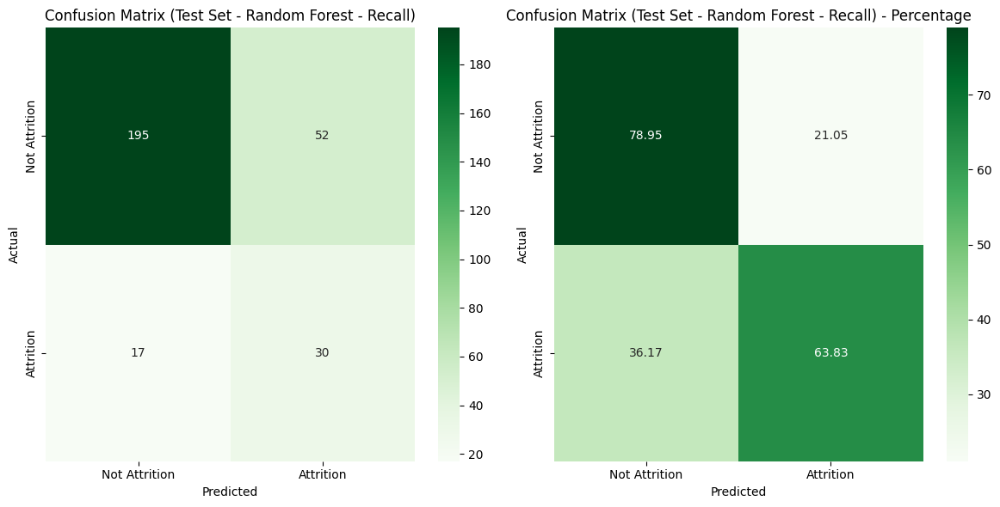

Random Forest Model Recall: 0.6382978723404256
Confusion Matrix (Absolute Values):
[[195  52]
 [ 17  30]]

Confusion Matrix (Percentage):
[[78.94736842 21.05263158]
 [36.17021277 63.82978723]]

Classification Report:
              precision    recall  f1-score   support

         0.0       0.92      0.79      0.85       247
         1.0       0.37      0.64      0.47        47

    accuracy                           0.77       294
   macro avg       0.64      0.71      0.66       294
weighted avg       0.83      0.77      0.79       294



In [602]:
X = data_for_model_3.drop(columns=['Attrition_Num'])
y = data_for_model_3['Attrition_Num']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# # Apply ADASYN to the training set
# adasyn = ADASYN(random_state=42)
# X_train_resampled, y_train_resampled = adasyn.fit_resample(X_train, y_train)

# Apply SMOTE-ENN to the training set
smote_enn = SMOTEENN(random_state=42)
X_train_resampled, y_train_resampled = smote_enn.fit_resample(X_train, y_train)

# Create a Random Forest model
rf_model = RandomForestClassifier(random_state=42)

# Define the hyperparameter grid for grid search
param_grid = {
    'n_estimators': [50, 100, 200],
    'max_depth': [None, 10, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'class_weight': [None, 'balanced']
}

# Instantiate GridSearchCV with scoring='recall'
grid_search_recall = GridSearchCV(rf_model, param_grid, cv=5, scoring='recall', n_jobs=-1)

# Fit the model to the resampled data
grid_search_recall.fit(X_train_resampled, y_train_resampled)

# Print the best parameters found by grid search for recall
print("Best Parameters for Random Forest (Recall):", grid_search_recall.best_params_)

# Make predictions on the test set using the best Random Forest model for recall
best_rf_model_recall = grid_search_recall.best_estimator_
y_pred_recall = best_rf_model_recall.predict(X_test)

# Evaluate the best Random Forest model for recall
accuracy_recall = recall_score(y_test, y_pred_recall)
conf_matrix_recall = confusion_matrix(y_test, y_pred_recall)
classification_rep_recall = classification_report(y_test, y_pred_recall)

# Plot the confusion matrix with absolute values
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
sns.heatmap(conf_matrix_recall, annot=True, fmt="d", cmap="Greens", xticklabels=['Not Attrition', 'Attrition'], yticklabels=['Not Attrition', 'Attrition'])
plt.title('Confusion Matrix (Test Set - Random Forest - Recall)')
plt.xlabel('Predicted')
plt.ylabel('Actual')

# Plot the confusion matrix with percentages
plt.subplot(1, 2, 2)
conf_matrix_percent = conf_matrix_recall / conf_matrix_recall.sum(axis=1)[:, np.newaxis] * 100  # Convert to percentage
sns.heatmap(conf_matrix_percent, annot=True, fmt=".2f", cmap="Greens", xticklabels=['Not Attrition', 'Attrition'], yticklabels=['Not Attrition', 'Attrition'])
plt.title('Confusion Matrix (Test Set - Random Forest - Recall) - Percentage')
plt.xlabel('Predicted')
plt.ylabel('Actual')

plt.tight_layout()
plt.show()

print(f"Random Forest Model Recall: {accuracy_recall}")
print("Confusion Matrix (Absolute Values):")
print(conf_matrix_recall)
print("\nConfusion Matrix (Percentage):")
print(conf_matrix_percent)
print("\nClassification Report:")
print(classification_rep_recall)



**__`5.5`__ Light GBM**

[LightGBM] [Info] Number of positive: 834, number of negative: 548
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000439 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1786
[LightGBM] [Info] Number of data points in the train set: 1382, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.603473 -> initscore=0.419958
[LightGBM] [Info] Start training from score 0.419958
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

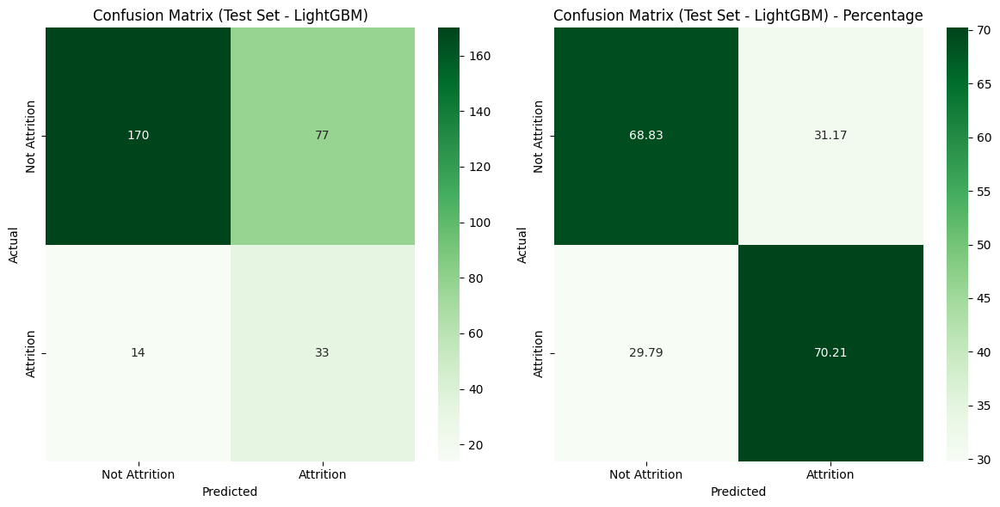

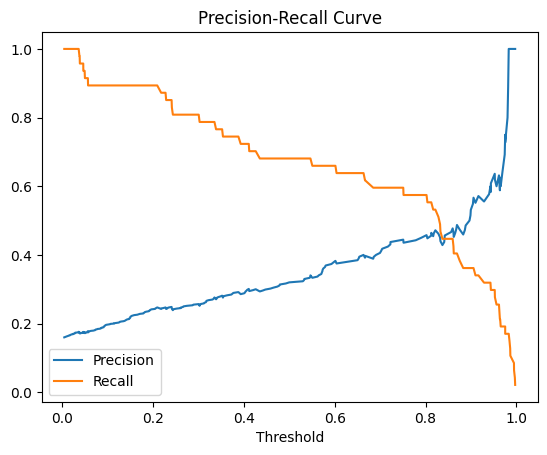

Best Threshold (F1 Score): 0.7907032157294512


In [601]:
X = data_for_model_3.drop(columns=['Attrition_Num'])
y = data_for_model_3['Attrition_Num']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Apply SMOTE-ENN to the training set
smote_enn = SMOTEENN(random_state=42)
X_train_resampled, y_train_resampled = smote_enn.fit_resample(X_train, y_train)

# # Apply ADASYN to the training set
# adasyn = ADASYN(random_state=42)
# X_train_resampled, y_train_resampled = adasyn.fit_resample(X_train, y_train)

# Create a LightGBM model with recommended settings for imbalanced data
lgb_model = LGBMClassifier(
    n_estimators=100,
    objective='binary',
    random_state=42,
    max_depth=3,               # Reduced max depth
    min_child_samples=50,      # Increased min_child_samples
    reg_alpha=0.5,             # Increased L1 regularization
    reg_lambda=0.5             # Increased L2 regularization
)

# Fit the model to the resampled data
lgb_model.fit(X_train_resampled, y_train_resampled)

# Make predictions on the test set

# Make predictions on the test set with probability
y_pred_proba = lgb_model.predict_proba(X_test)[:, 1]

threshold = 0.4222824134204635  # Use the desired threshold value
y_pred = (y_pred_proba > threshold).astype(int)

# Evaluate the model
accuracy_recall = recall_score(y_test, y_pred)
conf_matrix_recall = confusion_matrix(y_test, y_pred)
classification_rep_recall = classification_report(y_test, y_pred)

# Plot the confusion matrix with absolute values
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
sns.heatmap(conf_matrix_recall, annot=True, fmt="d", cmap="Greens", xticklabels=['Not Attrition', 'Attrition'], yticklabels=['Not Attrition', 'Attrition'])
plt.title('Confusion Matrix (Test Set - LightGBM)')
plt.xlabel('Predicted')
plt.ylabel('Actual')

# Plot the confusion matrix with percentages
plt.subplot(1, 2, 2)
conf_matrix_percent = conf_matrix_recall / conf_matrix_recall.sum(axis=1)[:, np.newaxis] * 100  # Convert to percentage
sns.heatmap(conf_matrix_percent, annot=True, fmt=".2f", cmap="Greens", xticklabels=['Not Attrition', 'Attrition'], yticklabels=['Not Attrition', 'Attrition'])
plt.title('Confusion Matrix (Test Set - LightGBM) - Percentage')
plt.xlabel('Predicted')
plt.ylabel('Actual')

plt.tight_layout()
plt.show()

from sklearn.metrics import precision_recall_curve
import matplotlib.pyplot as plt

precision, recall, thresholds = precision_recall_curve(y_test, y_pred_proba)

plt.plot(thresholds, precision[:-1], label='Precision')
plt.plot(thresholds, recall[:-1], label='Recall')
plt.xlabel('Threshold')
plt.title('Precision-Recall Curve')
plt.legend()
plt.show()

from sklearn.metrics import f1_score

f1_scores = [f1_score(y_test, (y_pred_proba > t).astype(int)) for t in thresholds]
best_threshold = thresholds[np.argmax(f1_scores)]

print(f"Best Threshold (F1 Score): {best_threshold}")





[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 797, number of negative: 562
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004376 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1530
[LightGBM] [Info] Number of data points in the train set: 1359, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.586461 -> initscore=0.349353
[LightGBM] [Info] Start training from score 0.349353
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No furt

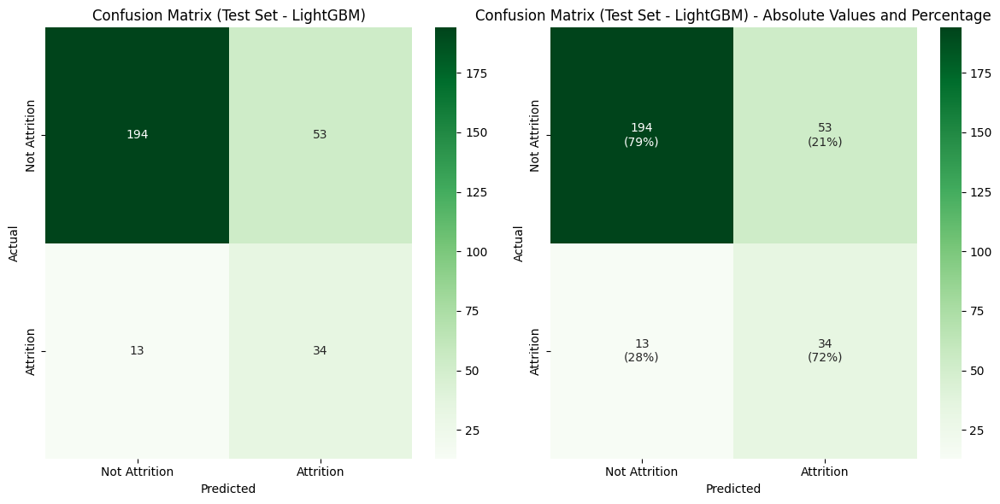

In [579]:
X = data_for_model_3.drop(columns=['Attrition_Num'])
y = data_for_model_3['Attrition_Num']

# Drop the 'DailyRate' column
X = X.drop(columns=['DailyRate'])

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Apply SMOTE-ENN to the training set
smote_enn = SMOTEENN(random_state=42)
X_train_resampled, y_train_resampled = smote_enn.fit_resample(X_train, y_train)

# Create a LightGBM model with recommended settings for imbalanced data
lgb_model = LGBMClassifier(
    n_estimators=100,
    objective='binary',
    random_state=42,
    max_depth=5,
    num_leaves=31,  # Adjust this parameter
    min_child_samples=30,
    reg_alpha=0.1,
    reg_lambda=0.1
)

# Fit the model to the resampled data
lgb_model.fit(X_train_resampled, y_train_resampled)

# After fitting the model
feature_importance = pd.DataFrame({
    'Feature': X_train.columns,
    'Importance': lgb_model.feature_importances_
})

# Sort features by importance in descending order
feature_importance = feature_importance.sort_values(by='Importance', ascending=False)
print(feature_importance)

# Make predictions on the test set with probability
y_pred_proba = lgb_model.predict_proba(X_test)[:, 1]

threshold = 0.4  # Experiment with different threshold values
y_pred = (y_pred_proba > threshold).astype(int)

# Evaluate the model
classification_rep = classification_report(y_test, y_pred)

# Print the classification report
print("Classification Report:\n", classification_rep)

conf_matrix = confusion_matrix(y_test, y_pred)
classification_rep = classification_report(y_test, y_pred)


# Plot the confusion matrix with absolute values and percentages
plt.figure(figsize=(12, 6))

# Plot the confusion matrix with absolute values
plt.subplot(1, 2, 1)
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Greens", xticklabels=['Not Attrition', 'Attrition'], yticklabels=['Not Attrition', 'Attrition'])
plt.title('Confusion Matrix (Test Set - LightGBM)')
plt.xlabel('Predicted')
plt.ylabel('Actual')

# Plot the confusion matrix with percentages
plt.subplot(1, 2, 2)
conf_matrix_percent = conf_matrix / conf_matrix.sum(axis=1)[:, np.newaxis] * 100  # Convert to percentage
annotations = [['{}\n({:.0f}%)'.format(value, percent) for value, percent in zip(row_absolute, row_percent)]
               for row_absolute, row_percent in zip(conf_matrix, conf_matrix_percent)]
sns.heatmap(conf_matrix, annot=annotations, fmt="", cmap="Greens", xticklabels=['Not Attrition', 'Attrition'], yticklabels=['Not Attrition', 'Attrition'])
plt.title('Confusion Matrix (Test Set - LightGBM) - Absolute Values and Percentage')
plt.xlabel('Predicted')
plt.ylabel('Actual')

plt.tight_layout()
plt.show()


[LightGBM] [Info] Number of positive: 532, number of negative: 374
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000366 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1305
[LightGBM] [Info] Number of data points in the train set: 906, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.587196 -> initscore=0.352388
[LightGBM] [Info] Start training from score 0.352388
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

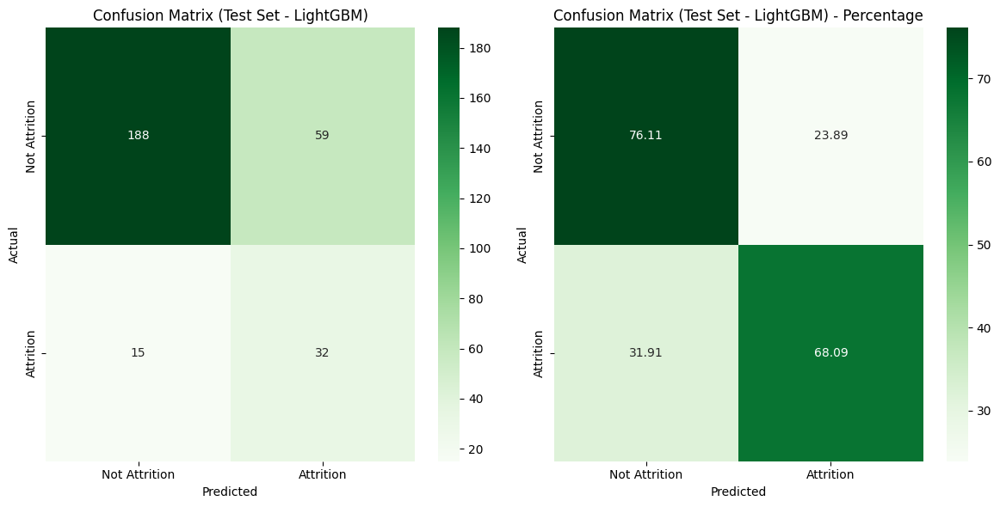

In [600]:
X = data_for_model_3.drop(columns=['Attrition_Num'])
y = data_for_model_3['Attrition_Num']

# Drop the 'DailyRate' column
X = X.drop(columns=['DailyRate'])

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Apply SMOTE-ENN to the training set
smote_enn = SMOTEENN(random_state=42)
X_train_resampled, y_train_resampled = smote_enn.fit_resample(X_train, y_train)

# Define the parameter grid for grid search
param_grid = {
    'n_estimators': [50, 100, 150],
    'max_depth': [3, 5, 7],
    'num_leaves': [15, 31, 50],
    'min_child_samples': [20, 30, 40],
    'reg_alpha': [0.05, 0.1, 0.5],
    'reg_lambda': [0.05, 0.1, 0.5]
}

# Create a LightGBM model
lgb_model = LGBMClassifier(objective='binary', random_state=42)

# Perform grid search with cross-validation
grid_search = GridSearchCV(lgb_model, param_grid, scoring='recall', cv=3)
grid_search.fit(X_train_resampled, y_train_resampled)

# Print the best parameters found
print("Best Parameters:", grid_search.best_params_)

# Get the best model
best_lgb_model = grid_search.best_estimator_

# After fitting the model
feature_importance = pd.DataFrame({
    'Feature': X_train.columns,
    'Importance': best_lgb_model.feature_importances_
})

# Sort features by importance in descending order
feature_importance = feature_importance.sort_values(by='Importance', ascending=False)
print(feature_importance)

# Make predictions on the test set with probability
y_pred_proba = best_lgb_model.predict_proba(X_test)[:, 1]

# Choose a threshold to maximize recall
thresholds = [0.4, 0.45, 0.5, 0.55, 0.6]  # Experiment with different threshold values
best_recall = 0
best_threshold = 0.5

for threshold in thresholds:
    y_pred = (y_pred_proba > threshold).astype(int)
    recall = recall_score(y_test, y_pred)
    
    if recall > best_recall:
        best_recall = recall
        best_threshold = threshold

# Use the best threshold
y_pred = (y_pred_proba > best_threshold).astype(int)

# Evaluate the model
accuracy_recall = recall_score(y_test, y_pred)
conf_matrix_recall = confusion_matrix(y_test, y_pred)
classification_rep_recall = classification_report(y_test, y_pred)

# Plot the confusion matrix with absolute values
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
sns.heatmap(conf_matrix_recall, annot=True, fmt="d", cmap="Greens", xticklabels=['Not Attrition', 'Attrition'], yticklabels=['Not Attrition', 'Attrition'])
plt.title('Confusion Matrix (Test Set - LightGBM)')
plt.xlabel('Predicted')
plt.ylabel('Actual')

# Plot the confusion matrix with percentages
plt.subplot(1, 2, 2)
conf_matrix_percent = conf_matrix_recall / conf_matrix_recall.sum(axis=1)[:, np.newaxis] * 100  # Convert to percentage
sns.heatmap(conf_matrix_percent, annot=True, fmt=".2f", cmap="Greens", xticklabels=['Not Attrition', 'Attrition'], yticklabels=['Not Attrition', 'Attrition'])
plt.title('Confusion Matrix (Test Set - LightGBM) - Percentage')
plt.xlabel('Predicted')
plt.ylabel('Actual')

plt.tight_layout()
plt.show()



In [581]:
pip show lightgbm


Name: lightgbmNote: you may need to restart the kernel to use updated packages.

Version: 4.1.0
Summary: LightGBM Python Package
Home-page: https://github.com/microsoft/LightGBM
Author: 
Author-email: 
License: The MIT License (MIT)

Copyright (c) Microsoft Corporation

Permission is hereby granted, free of charge, to any person obtaining a copy
of this software and associated documentation files (the "Software"), to deal
in the Software without restriction, including without limitation the rights
to use, copy, modify, merge, publish, distribute, sublicense, and/or sell
copies of the Software, and to permit persons to whom the Software is
furnished to do so, subject to the following conditions:

The above copyright notice and this permission notice shall be included in all
copies or substantial portions of the Software.

THE SOFTWARE IS PROVIDED "AS IS", WITHOUT WARRANTY OF ANY KIND, EXPRESS OR
IMPLIED, INCLUDING BUT NOT LIMITED TO THE WARRANTIES OF MERCHANTABILITY,
FITNESS FOR A PARTI

**__`5.6`__ Gradient Booster**

Best Threshold: 0.4
Accuracy: 0.7414965986394558
Recall: 0.7021276595744681

Confusion Matrix (Absolute Values):
[[185  62]
 [ 14  33]]


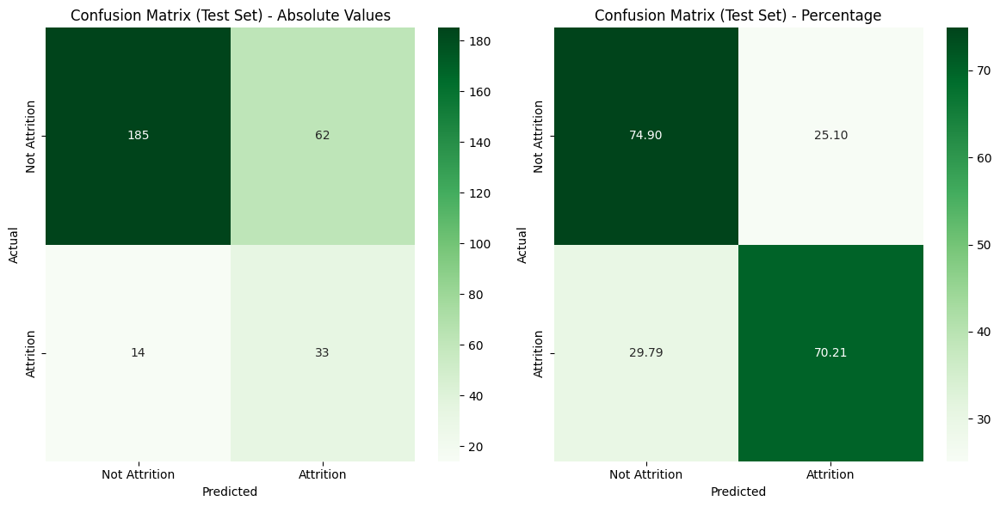


Classification Report:
              precision    recall  f1-score   support

         0.0       0.93      0.75      0.83       247
         1.0       0.35      0.70      0.46        47

    accuracy                           0.74       294
   macro avg       0.64      0.73      0.65       294
weighted avg       0.84      0.74      0.77       294



In [599]:
X = data_for_model_3.drop(columns=['Attrition_Num'])
y = data_for_model_3['Attrition_Num']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Create a pipeline with SMOTE-ENN and XGBoost
model = Pipeline([
    ('smote_enn', SMOTEENN(random_state=42)),
    ('xgb', xgb.XGBClassifier(
        n_estimators=100,
        max_depth=5,
        learning_rate=0.1,
        subsample=1.0,
        random_state=42,
        objective='binary:logistic',
        use_label_encoder=False  # To avoid warnings
    ))
])

# Fit the model to the training data
model.fit(X_train, y_train)

# Make predictions on the test set
y_pred_proba = model.predict_proba(X_test)[:, 1]

# Choose a threshold to maximize recall
thresholds = [0.4, 0.45, 0.5, 0.55, 0.6]  # Experiment with different threshold values
best_recall = 0
best_threshold = 0.5

for threshold in thresholds:
    y_pred = (y_pred_proba > threshold).astype(int)
    recall = recall_score(y_test, y_pred)
    
    if recall > best_recall:
        best_recall = recall
        best_threshold = threshold

# Use the best threshold
y_pred = (y_pred_proba > best_threshold).astype(int)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
recall = recall_score(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)
classification_rep = classification_report(y_test, y_pred)

# Print the results
print("Best Threshold:", best_threshold)
print("Accuracy:", accuracy)
print("Recall:", recall)

# Print Confusion Matrix (Absolute Values)
print("\nConfusion Matrix (Absolute Values):")
print(conf_matrix)

# Plot the confusion matrix with percentages
plt.figure(figsize=(12, 6))

# Plot Confusion Matrix (Percentage)
plt.subplot(1, 2, 1)
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Greens", xticklabels=['Not Attrition', 'Attrition'], yticklabels=['Not Attrition', 'Attrition'])
plt.title('Confusion Matrix (Test Set) - Absolute Values')
plt.xlabel('Predicted')
plt.ylabel('Actual')

# Plot Confusion Matrix (Percentage)
plt.subplot(1, 2, 2)
conf_matrix_percent = conf_matrix / conf_matrix.sum(axis=1)[:, np.newaxis] * 100  # Convert to percentage
sns.heatmap(conf_matrix_percent, annot=True, fmt=".2f", cmap="Greens", xticklabels=['Not Attrition', 'Attrition'], yticklabels=['Not Attrition', 'Attrition'])
plt.title('Confusion Matrix (Test Set) - Percentage')
plt.xlabel('Predicted')
plt.ylabel('Actual')

plt.tight_layout()
plt.show()

print("\nClassification Report:")
print(classification_rep)



**__`5.7`__ Neural Network**

10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
Accuracy: 0.6836734693877551
Recall: 0.7446808510638298

Confusion Matrix (Absolute Values):
[[166  81]
 [ 12  35]]


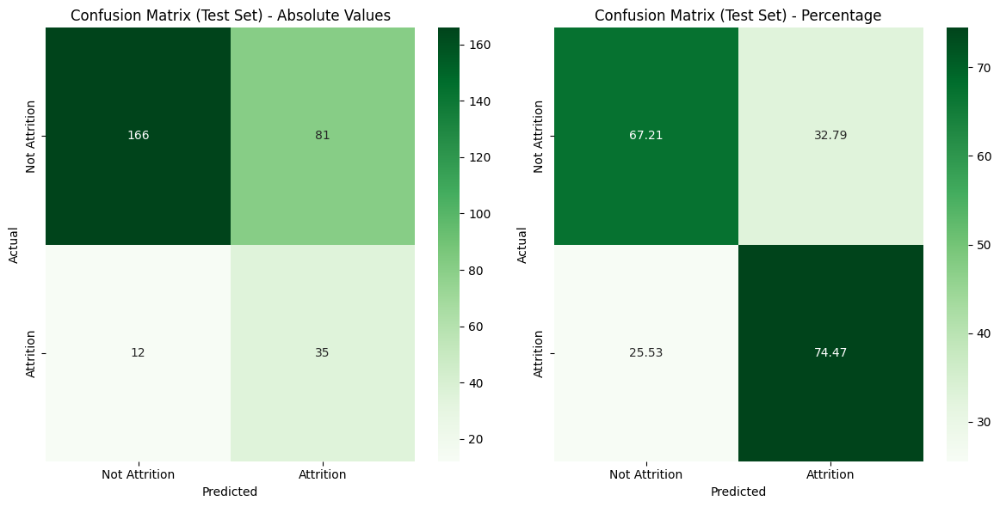


Classification Report:
              precision    recall  f1-score   support

         0.0       0.93      0.67      0.78       247
         1.0       0.30      0.74      0.43        47

    accuracy                           0.68       294
   macro avg       0.62      0.71      0.61       294
weighted avg       0.83      0.68      0.72       294



In [598]:
X = data_for_model_3.drop(columns=['Attrition_Num'])
y = data_for_model_3['Attrition_Num']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# # Apply ADASYN to the training set
# adasyn = ADASYN(random_state=42)
# X_train_resampled, y_train_resampled = adasyn.fit_resample(X_train, y_train)

# Apply SMOTE-ENN to the training set
smote_enn = SMOTEENN(random_state=42)
X_train_resampled, y_train_resampled = smote_enn.fit_resample(X_train, y_train)

# Standardize features if needed
scaler = StandardScaler()
X_train_resampled_scaled = scaler.fit_transform(X_train_resampled)
X_test_scaled = scaler.transform(X_test)

# Create a neural network model
model = Sequential()
model.add(Dense(100, input_dim=X_train_resampled_scaled.shape[1], activation='relu'))
model.add(Dense(1, activation='sigmoid'))

# Compile the model
model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Fit the model to the resampled and scaled data
model.fit(X_train_resampled_scaled, y_train_resampled, epochs=20, batch_size=32, verbose=0)

# Make predictions on the test set
y_pred_proba = model.predict(X_test_scaled)
y_pred = (y_pred_proba > 0.5).astype(int)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
recall = recall_score(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)
classification_rep = classification_report(y_test, y_pred)

# Print the results
print("Accuracy:", accuracy)
print("Recall:", recall)

# Print Confusion Matrix (Absolute Values)
print("\nConfusion Matrix (Absolute Values):")
print(conf_matrix)

# Plot the confusion matrix with percentages
plt.figure(figsize=(12, 6))

# Plot Confusion Matrix (Percentage)
plt.subplot(1, 2, 1)
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Greens", xticklabels=['Not Attrition', 'Attrition'], yticklabels=['Not Attrition', 'Attrition'])
plt.title('Confusion Matrix (Test Set) - Absolute Values')
plt.xlabel('Predicted')
plt.ylabel('Actual')

# Plot Confusion Matrix (Percentage)
plt.subplot(1, 2, 2)
conf_matrix_percent = conf_matrix / conf_matrix.sum(axis=1)[:, np.newaxis] * 100  # Convert to percentage
sns.heatmap(conf_matrix_percent, annot=True, fmt=".2f", cmap="Greens", xticklabels=['Not Attrition', 'Attrition'], yticklabels=['Not Attrition', 'Attrition'])
plt.title('Confusion Matrix (Test Set) - Percentage')
plt.xlabel('Predicted')
plt.ylabel('Actual')

plt.tight_layout()
plt.show()

print("\nClassification Report:")
print(classification_rep)



Epoch 1/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step - accuracy: 0.7413 - loss: 0.7768
Epoch 2/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8094 - loss: 0.6733
Epoch 3/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8211 - loss: 0.5661 
Epoch 4/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.7835 - loss: 0.6972 
Epoch 5/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7869 - loss: 0.5546
Epoch 6/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8162 - loss: 0.5923
Epoch 7/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.7925 - loss: 0.6806
Epoch 8/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8248 - loss: 0.5646
Epoch 9/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8176 - loss: 0.5419
Epoch 10/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8137 - loss: 0.5256
Epoch 11/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7658 - loss: 0.5532
Epoch 12/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7959 - 

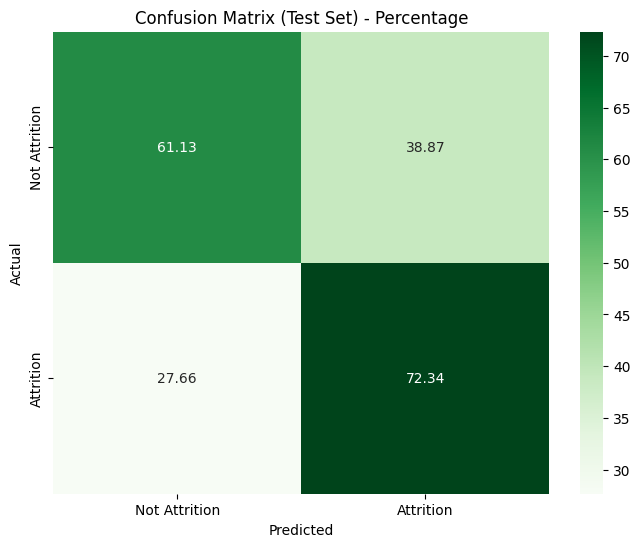


Classification Report:
              precision    recall  f1-score   support

         0.0       0.92      0.61      0.73       247
         1.0       0.26      0.72      0.38        47

    accuracy                           0.63       294
   macro avg       0.59      0.67      0.56       294
weighted avg       0.82      0.63      0.68       294



In [597]:
X = data_for_model_3.drop(columns=['Attrition_Num'])
y = data_for_model_3['Attrition_Num']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Apply SMOTE-ENN to the training set
smote_enn = SMOTEENN(random_state=42)
X_train_resampled, y_train_resampled = smote_enn.fit_resample(X_train, y_train)

# Calculate class weights to handle imbalanced data
class_weights = class_weight.compute_class_weight('balanced', classes=np.unique(y_train_resampled), y=y_train_resampled)

# Convert class weights to dictionary
class_weights_dict = dict(enumerate(class_weights))

# Scale the features
scaler = StandardScaler()
X_train_resampled_scaled = scaler.fit_transform(X_train_resampled)
X_test_scaled = scaler.transform(X_test)

# Create a deeper neural network model with batch normalization using the best parameters
model = Sequential()
model.add(Dense(32, input_dim=X_train_resampled_scaled.shape[1], activation='relu', kernel_regularizer=tf.keras.regularizers.l2(0.01)))
model.add(BatchNormalization())
model.add(Dense(8, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(0.01)))
model.add(Dense(1, activation='sigmoid'))

# Compile the model
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.1), loss='binary_crossentropy', metrics=['accuracy'])

# Fit the model to the resampled and scaled data
model.fit(X_train_resampled_scaled, y_train_resampled, epochs=20, batch_size=32, class_weight=class_weights_dict, verbose=1)

# Make predictions on the test set
y_pred_proba = model.predict(X_test_scaled)
y_pred = (y_pred_proba > 0.5).astype(int)

# Evaluate the model metrics
accuracy = accuracy_score(y_test, y_pred)
recall = recall_score(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)
classification_rep = classification_report(y_test, y_pred)

# Print the results
print("Accuracy:", accuracy)
print("Recall:", recall)
print("\nConfusion Matrix (Absolute Values):")
print(conf_matrix)

# Plot the confusion matrix with percentages
plt.figure(figsize=(8, 6))
conf_matrix_percent = conf_matrix / conf_matrix.sum(axis=1)[:, np.newaxis] * 100  # Convert to percentage
sns.heatmap(conf_matrix_percent, annot=True, fmt=".2f", cmap="Greens", xticklabels=['Not Attrition', 'Attrition'], yticklabels=['Not Attrition', 'Attrition'])
plt.title('Confusion Matrix (Test Set) - Percentage')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

print("\nClassification Report:")
print(classification_rep)



Epoch 1/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - accuracy: 0.6818 - loss: 0.6202
Epoch 2/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8342 - loss: 0.3962
Epoch 3/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8644 - loss: 0.3543
Epoch 4/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.8812 - loss: 0.3303
Epoch 5/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.8751 - loss: 0.3237
Epoch 6/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9071 - loss: 0.2777
Epoch 7/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9014 - loss: 0.2880
Epoch 8/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9101 - loss: 0.2473
Epoch 9/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9141 - loss: 0.2440
Epoch 10/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9254 - loss: 0.2263
Epoch 11/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.9247 - loss: 0.2371
Epoch 12/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9464 - lo

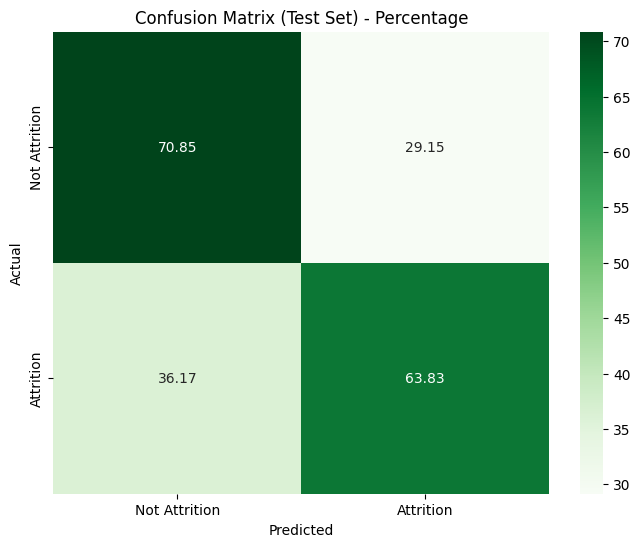


Classification Report:
              precision    recall  f1-score   support

         0.0       0.91      0.71      0.80       247
         1.0       0.29      0.64      0.40        47

    accuracy                           0.70       294
   macro avg       0.60      0.67      0.60       294
weighted avg       0.81      0.70      0.73       294



In [596]:
X = data_for_model_3.drop(columns=['Attrition_Num'])
y = data_for_model_3['Attrition_Num']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Apply SMOTE-ENN to the training set
smote_enn = SMOTEENN(random_state=42)
X_train_resampled, y_train_resampled = smote_enn.fit_resample(X_train, y_train)

# Calculate class weights to handle imbalanced data
class_weights = class_weight.compute_class_weight('balanced', classes=np.unique(y_train_resampled), y=y_train_resampled)

# Convert class weights to dictionary
class_weights_dict = dict(enumerate(class_weights))

# Scale the features
scaler = StandardScaler()
X_train_resampled_scaled = scaler.fit_transform(X_train_resampled)
X_test_scaled = scaler.transform(X_test)

# Create a deeper neural network model with batch normalization using the best parameters
model = Sequential()
model.add(Dense(32, input_dim=X_train_resampled_scaled.shape[1], activation='relu', kernel_regularizer=tf.keras.regularizers.l2(0.001)))
model.add(BatchNormalization())
model.add(Dense(8, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(0.001)))
model.add(Dense(1, activation='sigmoid'))

# Compile the model
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.01), loss='binary_crossentropy', metrics=['accuracy'])

# Fit the model to the resampled and scaled data
model.fit(X_train_resampled_scaled, y_train_resampled, epochs=20, batch_size=32, class_weight=class_weights_dict, verbose=1)

# Make predictions on the test set
y_pred_proba = model.predict(X_test_scaled)
y_pred = (y_pred_proba > 0.5).astype(int)

# Evaluate the model metrics
accuracy = accuracy_score(y_test, y_pred)
recall = recall_score(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)
classification_rep = classification_report(y_test, y_pred)

# Print the results
print("Accuracy:", accuracy)
print("Recall:", recall)
print("\nConfusion Matrix (Absolute Values):")
print(conf_matrix)

# Plot the confusion matrix with percentages
plt.figure(figsize=(8, 6))
conf_matrix_percent = conf_matrix / conf_matrix.sum(axis=1)[:, np.newaxis] * 100  # Convert to percentage
sns.heatmap(conf_matrix_percent, annot=True, fmt=".2f", cmap="Greens", xticklabels=['Not Attrition', 'Attrition'], yticklabels=['Not Attrition', 'Attrition'])
plt.title('Confusion Matrix (Test Set) - Percentage')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

print("\nClassification Report:")
print(classification_rep)

Epoch 1/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.5049 - loss: 2.8060 - val_accuracy: 0.4152 - val_loss: 0.9872 - learning_rate: 0.0010
Epoch 2/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5761 - loss: 2.2554 - val_accuracy: 0.8339 - val_loss: 0.8978 - learning_rate: 0.0010
Epoch 3/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6123 - loss: 1.9205 - val_accuracy: 0.8845 - val_loss: 0.8238 - learning_rate: 0.0010
Epoch 4/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6462 - loss: 1.7216 - val_accuracy: 0.9458 - val_loss: 0.7354 - learning_rate: 0.0010
Epoch 5/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6366 - loss: 1.5547 - val_accuracy: 0.9711 - val_loss: 0.6583 - learning_rate: 0.0010
Epoch 6/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6672 - loss: 1.3908 - val_accuracy: 0.9819 - val_loss: 0.5996 - learning_rate: 0.0010
Epoch 7/20
35/35 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.6701 - loss: 1.3975 - val_accuracy: 

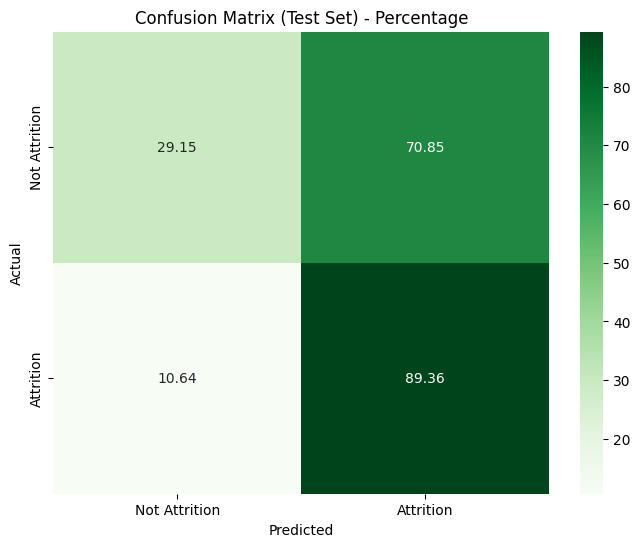


Classification Report:
              precision    recall  f1-score   support

         0.0       0.94      0.29      0.44       247
         1.0       0.19      0.89      0.32        47

    accuracy                           0.39       294
   macro avg       0.56      0.59      0.38       294
weighted avg       0.82      0.39      0.42       294



In [595]:
X = data_for_model_3.drop(columns=['Attrition_Num'])
y = data_for_model_3['Attrition_Num']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Apply SMOTE-ENN to the training set
smote_enn = SMOTEENN(random_state=42)
X_train_resampled, y_train_resampled = smote_enn.fit_resample(X_train, y_train)

# Calculate class weights with higher penalization for the positive class
class_weights = class_weight.compute_class_weight('balanced', classes=np.unique(y_train_resampled), y=y_train_resampled)

# Manually adjust the class weight for the positive class (index 1)
positive_class_weight = 5.0  # You can experiment with different weight values
class_weights[1] *= positive_class_weight

# Convert class weights to dictionary
class_weights_dict = dict(enumerate(class_weights))

# Regularization strength (adjust as needed)
l2_strength = 0.01

# Define ReduceLROnPlateau callback
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=5, min_lr=1e-6)

# Creating a neural network model with adjusted hyperparameters
model = tf.keras.Sequential([
    tf.keras.layers.Dense(32, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(l2_strength), input_shape=(X_train_resampled.shape[1],)),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Dropout(0.5),  # Adding dropout with a dropout rate of 0.5 (you can adjust this rate)
    tf.keras.layers.Dense(8, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(l2_strength)),
      # Adding dropout with a dropout rate of 0.5 (you can adjust this rate)
    tf.keras.layers.Dense(1, activation='sigmoid')
])

# Compile the model
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])


history = model.fit(
    X_train_resampled, y_train_resampled,
    epochs=20, batch_size=32,
    validation_split=0.2,
    class_weight=class_weights_dict,  # Use the dictionary here
    callbacks=[reduce_lr]
)
# Make predictions on the test set
y_pred_proba = model.predict(X_test)
y_pred = (y_pred_proba > 0.5).astype(int)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
recall = recall_score(y_test, y_pred)
conf_matrix = confusion_matrix(y_test, y_pred)
classification_rep = classification_report(y_test, y_pred)

# Print the results
print("Accuracy:", accuracy)
print("Recall:", recall)
print("\nConfusion Matrix (Absolute Values):")
print(conf_matrix)

# Plot the confusion matrix with percentages
plt.figure(figsize=(8, 6))
conf_matrix_percent = conf_matrix / conf_matrix.sum(axis=1)[:, np.newaxis] * 100  # Convert to percentage
sns.heatmap(conf_matrix_percent, annot=True, fmt=".2f", cmap="Greens", xticklabels=['Not Attrition', 'Attrition'], yticklabels=['Not Attrition', 'Attrition'])
plt.title('Confusion Matrix (Test Set) - Percentage')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

print("\nClassification Report:")
print(classification_rep)


**__`5.7`__ CAT Boost**

Learning rate set to 0.09701
0:	learn: 0.6607502	total: 1.52ms	remaining: 151ms
1:	learn: 0.6310501	total: 3.55ms	remaining: 174ms
2:	learn: 0.6018856	total: 5.44ms	remaining: 176ms
3:	learn: 0.5775457	total: 8.72ms	remaining: 209ms
4:	learn: 0.5571022	total: 9.93ms	remaining: 189ms
5:	learn: 0.5368582	total: 11.5ms	remaining: 180ms
6:	learn: 0.5183597	total: 13.6ms	remaining: 181ms
7:	learn: 0.5040308	total: 15.4ms	remaining: 178ms
8:	learn: 0.4909029	total: 17.3ms	remaining: 174ms
9:	learn: 0.4757466	total: 19.1ms	remaining: 172ms
10:	learn: 0.4667168	total: 22.2ms	remaining: 179ms
11:	learn: 0.4564259	total: 23.7ms	remaining: 174ms
12:	learn: 0.4456088	total: 25.2ms	remaining: 168ms
13:	learn: 0.4369579	total: 26.5ms	remaining: 163ms
14:	learn: 0.4274200	total: 31.6ms	remaining: 179ms
15:	learn: 0.4202961	total: 35.6ms	remaining: 187ms
16:	learn: 0.4138507	total: 38.4ms	remaining: 188ms
17:	learn: 0.4063644	total: 40.2ms	remaining: 183ms
18:	learn: 0.3998343	total: 41.5ms	remaining:

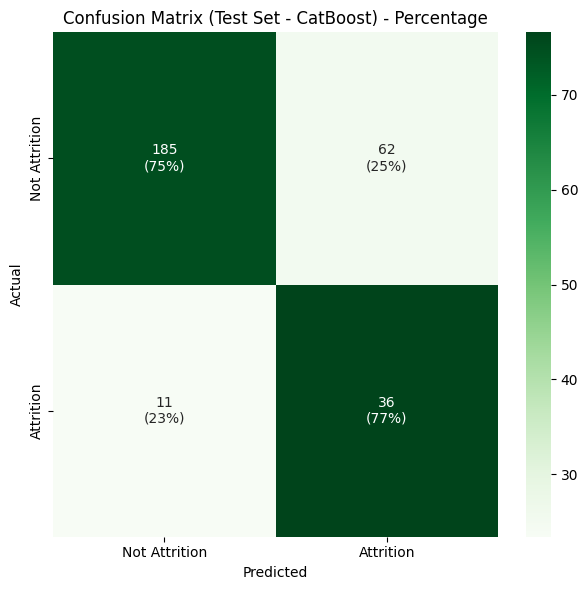

In [587]:
X = data_for_model_3.drop(columns=['Attrition_Num'])
y = data_for_model_3['Attrition_Num']

# Drop the 'DailyRate' column
X = X.drop(columns=['DailyRate'])

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Apply SMOTE-ENN to the training set
smote_enn = SMOTEENN(random_state=42)
X_train_resampled, y_train_resampled = smote_enn.fit_resample(X_train, y_train)

# # Apply ADASYN to the training set
# adasyn = ADASYN(random_state=42)
# X_train_resampled, y_train_resampled = adasyn.fit_resample(X_train, y_train)

# Create a CatBoost model
catboost_model = CatBoostClassifier(iterations=100, depth=5, random_state=42, cat_features=[])

# Fit the model to the resampled data
catboost_model.fit(X_train_resampled, y_train_resampled)

# After fitting the model
feature_importance = pd.DataFrame({
    'Feature': X_train.columns,
    'Importance': catboost_model.feature_importances_
})

# Sort features by importance in descending order
feature_importance = feature_importance.sort_values(by='Importance', ascending=False)
print(feature_importance)

# Make predictions on the test set
y_pred = catboost_model.predict(X_test)

# Evaluate the model
conf_matrix = confusion_matrix(y_test, y_pred)
classification_rep = classification_report(y_test, y_pred)

# Print the classification report
print("Classification Report:\n", classification_rep)

# Plot the confusion matrix with percentages
plt.figure(figsize=(12, 6))

# Plot the confusion matrix with percentages
plt.subplot(1, 2, 2)
conf_matrix_percent = conf_matrix / conf_matrix.sum(axis=1)[:, np.newaxis] * 100  # Convert to percentage
annotations = [['{}\n({:.0f}%)'.format(value, percent) for value, percent in zip(row, row_percent)]
               for row, row_percent in zip(conf_matrix, conf_matrix_percent)]
sns.heatmap(conf_matrix_percent, annot=annotations, fmt="", cmap="Greens",
            xticklabels=['Not Attrition', 'Attrition'], yticklabels=['Not Attrition', 'Attrition'])
plt.title('Confusion Matrix (Test Set - CatBoost) - Percentage')
plt.xlabel('Predicted')
plt.ylabel('Actual')

plt.tight_layout()
plt.show()


0:	learn: 0.6592083	total: 1.79ms	remaining: 177ms
1:	learn: 0.6285911	total: 3.27ms	remaining: 160ms
2:	learn: 0.6031198	total: 4.63ms	remaining: 150ms
3:	learn: 0.5786687	total: 6.02ms	remaining: 145ms
4:	learn: 0.5580364	total: 7.3ms	remaining: 139ms
5:	learn: 0.5387863	total: 8.84ms	remaining: 139ms
6:	learn: 0.5187244	total: 10ms	remaining: 133ms
7:	learn: 0.5031076	total: 11.2ms	remaining: 129ms
8:	learn: 0.4891413	total: 12.3ms	remaining: 124ms
9:	learn: 0.4747742	total: 13.5ms	remaining: 122ms
10:	learn: 0.4641533	total: 14.8ms	remaining: 120ms
11:	learn: 0.4517080	total: 16ms	remaining: 118ms
12:	learn: 0.4406522	total: 17.4ms	remaining: 117ms
13:	learn: 0.4306958	total: 19.5ms	remaining: 120ms
14:	learn: 0.4219280	total: 21.1ms	remaining: 120ms
15:	learn: 0.4143794	total: 22.7ms	remaining: 119ms
16:	learn: 0.4071508	total: 24.1ms	remaining: 118ms
17:	learn: 0.3983533	total: 25.5ms	remaining: 116ms
18:	learn: 0.3923212	total: 26.9ms	remaining: 115ms
19:	learn: 0.3857465	total:

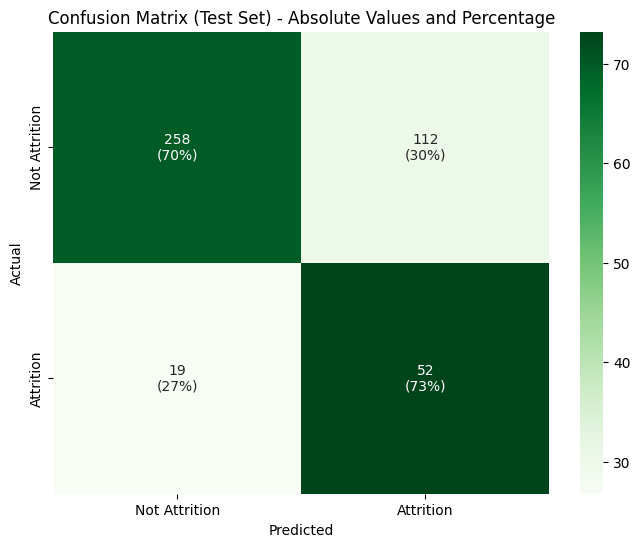

In [588]:
X = data_for_model_3.drop(columns=['Attrition_Num'])
y = data_for_model_3['Attrition_Num']

# Drop the 'DailyRate' column
X = X.drop(columns=['DailyRate'])

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42, stratify=y)

# Apply SMOTE-ENN to the training set
smote_enn = SMOTEENN(random_state=42)
X_train_resampled, y_train_resampled = smote_enn.fit_resample(X_train, y_train)

# Create a CatBoost model
catboost_model = CatBoostClassifier(iterations=100, depth=5, l2_leaf_reg=5, learning_rate=0.1, random_state=42, cat_features=[])

# Fit the model to the resampled data
catboost_model.fit(X_train_resampled, y_train_resampled)

# After fitting the model
feature_importance = pd.DataFrame({
    'Feature': X_train.columns,
    'Importance': catboost_model.feature_importances_
})

# Sort features by importance in descending order
feature_importance = feature_importance.sort_values(by='Importance', ascending=False)
print(feature_importance)

# Make predictions on the training set
y_train_pred = catboost_model.predict(X_train_resampled)

# Calculate precision, recall, and f1-score for the training set
train_precision, train_recall, train_f1_score, _ = precision_recall_fscore_support(y_train_resampled, y_train_pred, average='binary')
train_accuracy = accuracy_score(y_train_resampled, y_train_pred)

# Print the metrics for the training set
print("\nTraining Metrics:")
print(f"Accuracy: {train_accuracy}")
print(f"Precision: {train_precision}")
print(f"Recall: {train_recall}")
print(f"F1-Score: {train_f1_score}")

# Make predictions on the validation set
y_val_pred = catboost_model.predict(X_test)

# Calculate precision, recall, and f1-score for the validation set
val_precision, val_recall, val_f1_score, _ = precision_recall_fscore_support(y_test, y_val_pred, average='binary')
val_accuracy = accuracy_score(y_test, y_val_pred)

# Print the metrics for the validation set
print("\nValidation Metrics:")
print(f"Accuracy: {val_accuracy}")
print(f"Precision: {val_precision}")
print(f"Recall: {val_recall}")
print(f"F1-Score: {val_f1_score}")

# Plot the confusion matrix with percentages
plt.figure(figsize=(8, 6))

# Calculate confusion matrix with absolute values
conf_matrix_absolute = confusion_matrix(y_test, y_val_pred)

# Calculate confusion matrix with percentages
conf_matrix_percent = conf_matrix_absolute / conf_matrix_absolute.sum(axis=1)[:, np.newaxis] * 100  # Convert to percentage

# Create an array to store annotations with both absolute and percentage values
annotations = [['{}\n({:.0f}%)'.format(value, percent) for value, percent in zip(row_absolute, row_percent)]
               for row_absolute, row_percent in zip(conf_matrix_absolute, conf_matrix_percent)]

# Plot the confusion matrix
sns.heatmap(conf_matrix_percent, annot=annotations, fmt="", cmap="Greens",
            xticklabels=['Not Attrition', 'Attrition'], yticklabels=['Not Attrition', 'Attrition'])
plt.title('Confusion Matrix (Test Set) - Absolute Values and Percentage')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()



**__`5.8`__ SVM**


Training Metrics:
Accuracy: 0.847571189279732
Precision: 0.8569553805774278
Recall: 0.8994490358126722
F1-Score: 0.8776881720430108

Validation Metrics:
Accuracy: 0.6145124716553289
Precision: 0.25853658536585367
Recall: 0.7464788732394366
F1-Score: 0.3840579710144927


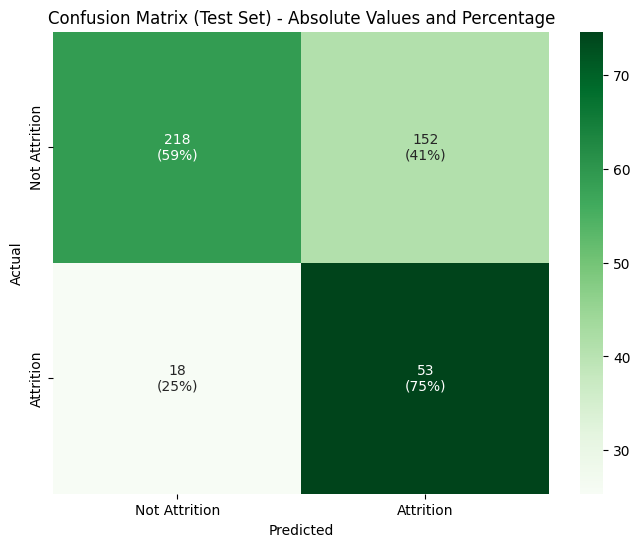

In [589]:
X = data_for_model_3.drop(columns=['Attrition_Num'])
y = data_for_model_3['Attrition_Num']

# # Drop the 'DailyRate' column
# X = X.drop(columns=['DailyRate'])

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42, stratify=y)

# Apply SMOTE-ENN to the training set
smote_enn = SMOTEENN(random_state=42)
X_train_resampled, y_train_resampled = smote_enn.fit_resample(X_train, y_train)

# Create an SVM model
svm_model = SVC(kernel='linear', random_state=42)

# Fit the model to the resampled data
svm_model.fit(X_train_resampled, y_train_resampled)

# Make predictions on the training set
y_train_pred = svm_model.predict(X_train_resampled)

# Calculate precision, recall, and f1-score for the training set
train_precision, train_recall, train_f1_score, _ = precision_recall_fscore_support(y_train_resampled, y_train_pred, average='binary')
train_accuracy = accuracy_score(y_train_resampled, y_train_pred)

# Print the metrics for the training set
print("\nTraining Metrics:")
print(f"Accuracy: {train_accuracy}")
print(f"Precision: {train_precision}")
print(f"Recall: {train_recall}")
print(f"F1-Score: {train_f1_score}")

# Make predictions on the validation set
y_val_pred = svm_model.predict(X_test)

# Calculate precision, recall, and f1-score for the validation set
val_precision, val_recall, val_f1_score, _ = precision_recall_fscore_support(y_test, y_val_pred, average='binary')
val_accuracy = accuracy_score(y_test, y_val_pred)

# Print the metrics for the validation set
print("\nValidation Metrics:")
print(f"Accuracy: {val_accuracy}")
print(f"Precision: {val_precision}")
print(f"Recall: {val_recall}")
print(f"F1-Score: {val_f1_score}")

# Plot the confusion matrix with percentages
plt.figure(figsize=(8, 6))

# Calculate confusion matrix with absolute values
conf_matrix_absolute = confusion_matrix(y_test, y_val_pred)

# Calculate confusion matrix with percentages
conf_matrix_percent = conf_matrix_absolute / conf_matrix_absolute.sum(axis=1)[:, np.newaxis] * 100  # Convert to percentage

# Create an array to store annotations with both absolute and percentage values
annotations = [['{}\n({:.0f}%)'.format(value, percent) for value, percent in zip(row_absolute, row_percent)]
               for row_absolute, row_percent in zip(conf_matrix_absolute, conf_matrix_percent)]

# Plot the confusion matrix
sns.heatmap(conf_matrix_percent, annot=annotations, fmt="", cmap="Greens",
            xticklabels=['Not Attrition', 'Attrition'], yticklabels=['Not Attrition', 'Attrition'])
plt.title('Confusion Matrix (Test Set) - Absolute Values and Percentage')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()


Learning rate set to 0.093071
0:	learn: 0.6620127	test: 0.6781855	best: 0.6781855 (0)	total: 2.15ms	remaining: 213ms
20:	learn: 0.3922961	test: 0.6331200	best: 0.6237008 (9)	total: 34.2ms	remaining: 129ms
Stopped by overfitting detector  (20 iterations wait)

bestTest = 0.6237008385
bestIteration = 9

Shrink model to first 10 iterations.
                   Feature  Importance
8            OverTime_Flag   29.649472
2     YearsWithCurrManager   17.848919
9         StockOptionLevel   16.978093
0                      Age   13.891857
1            MonthlyIncome    7.363132
4           JobInvolvement    7.035352
6              Travel_Flag    3.163144
7       MaritalStatus_Flag    2.163826
3         DistanceFromHome    1.204558
5  YearsSinceLastPromotion    0.701648
Classification Report:
               precision    recall  f1-score   support

         0.0       0.95      0.67      0.78       247
         1.0       0.32      0.81      0.46        47

    accuracy                           0.69

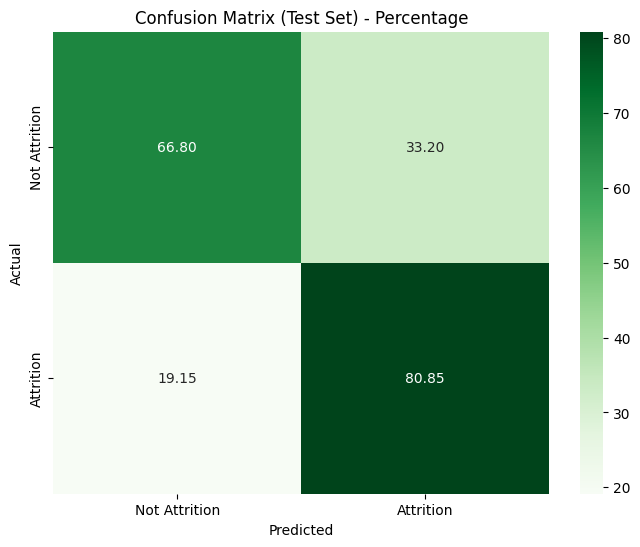

In [590]:
X = data_for_model_3.drop(columns=['Attrition_Num'])
y = data_for_model_3['Attrition_Num']

# Drop the 'DailyRate' column
X = X.drop(columns=['DailyRate'])

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Apply SMOTE-ENN to the training set
smote_enn = SMOTEENN(random_state=42)
X_train_resampled, y_train_resampled = smote_enn.fit_resample(X_train, y_train)

# Create a CatBoost model
catboost_model = CatBoostClassifier(iterations=100, depth=5, random_state=42, cat_features=[])

# Fit the model to the resampled data
catboost_model.fit(X_train_resampled, y_train_resampled, eval_set=(X_test, y_test), early_stopping_rounds=20, verbose=20)

# After fitting the model
feature_importance = pd.DataFrame({
    'Feature': X_train.columns,
    'Importance': catboost_model.feature_importances_
})

# Sort features by importance in descending order
feature_importance = feature_importance.sort_values(by='Importance', ascending=False)
print(feature_importance)

# Make predictions on the test set
y_pred = catboost_model.predict(X_test)

# Evaluate the model
conf_matrix = confusion_matrix(y_test, y_pred)
classification_rep = classification_report(y_test, y_pred)

# Print the classification report
print("Classification Report:\n", classification_rep)

# Get training and validation metrics
train_accuracy = catboost_model.score(X_train_resampled, y_train_resampled)
val_accuracy = catboost_model.score(X_test, y_test)

# Print the metrics
print("\nTraining Metrics:")
print(f"Accuracy: {train_accuracy}")
print("\nValidation Metrics:")
print(f"Accuracy: {val_accuracy}")

# Plot the confusion matrix with percentages
plt.figure(figsize=(8, 6))
conf_matrix_percent = conf_matrix / conf_matrix.sum(axis=1)[:, np.newaxis] * 100  # Convert to percentage
sns.heatmap(conf_matrix_percent, annot=True, fmt=".2f", cmap="Greens", xticklabels=['Not Attrition', 'Attrition'], yticklabels=['Not Attrition', 'Attrition'])
plt.title('Confusion Matrix (Test Set) - Percentage')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()



0:	learn: 0.6348130	total: 3.09ms	remaining: 3.09s
1:	learn: 0.5700812	total: 5.91ms	remaining: 2.95s
2:	learn: 0.5249154	total: 9.16ms	remaining: 3.04s
3:	learn: 0.4848155	total: 12.1ms	remaining: 3.01s
4:	learn: 0.4642194	total: 15ms	remaining: 2.99s
5:	learn: 0.4298641	total: 18.1ms	remaining: 2.99s
6:	learn: 0.4073374	total: 21.4ms	remaining: 3.04s
7:	learn: 0.3913586	total: 24.2ms	remaining: 3s
8:	learn: 0.3735436	total: 27.4ms	remaining: 3.02s
9:	learn: 0.3588721	total: 31.3ms	remaining: 3.1s
10:	learn: 0.3421095	total: 34.7ms	remaining: 3.12s
11:	learn: 0.3323586	total: 42.7ms	remaining: 3.52s
12:	learn: 0.3144503	total: 50ms	remaining: 3.79s
13:	learn: 0.3059636	total: 54.6ms	remaining: 3.85s
14:	learn: 0.2968204	total: 60ms	remaining: 3.94s
15:	learn: 0.2909789	total: 65.5ms	remaining: 4.03s
16:	learn: 0.2791743	total: 69.6ms	remaining: 4.03s
17:	learn: 0.2730456	total: 72.8ms	remaining: 3.97s
18:	learn: 0.2682823	total: 77.3ms	remaining: 3.99s
19:	learn: 0.2600790	total: 80.8

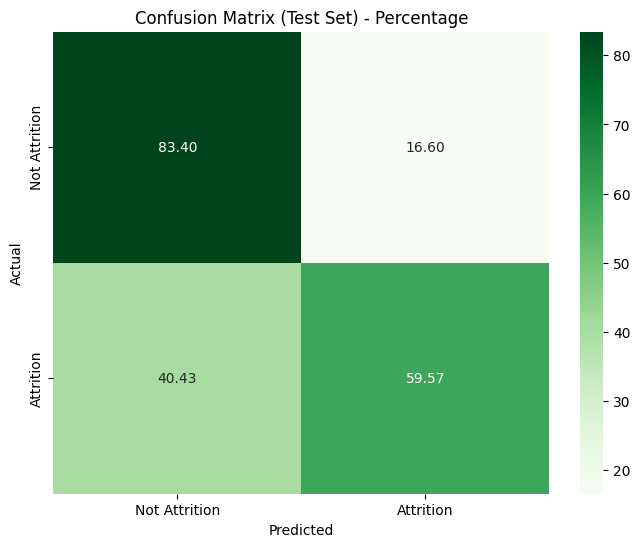

In [591]:
X = data_for_model_3.drop(columns=['Attrition_Num'])
y = data_for_model_3['Attrition_Num']

# Drop the 'DailyRate' column
X = X.drop(columns=['DailyRate'])

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Apply SMOTE-ENN to the training set
smote_enn = SMOTEENN(random_state=42)
X_train_resampled, y_train_resampled = smote_enn.fit_resample(X_train, y_train)

# Create a CatBoost model with recommended parameters
catboost_model = CatBoostClassifier(
    iterations=1000,  # You may adjust this based on the dataset size
    depth=6,          # Experiment with depth based on dataset complexity
    learning_rate=0.1, # Typically, a moderate learning rate works well
    l2_leaf_reg=3,     # Regularization parameter, helps with overfitting
    random_state=42,
    cat_features=[]
)

# Fit the model to the resampled data
catboost_model.fit(X_train_resampled, y_train_resampled)

# After fitting the model
feature_importance = pd.DataFrame({
    'Feature': X_train.columns,
    'Importance': catboost_model.feature_importances_
})

# Sort features by importance in descending order
feature_importance = feature_importance.sort_values(by='Importance', ascending=False)
print(feature_importance)

# Make predictions on the test set
y_pred = catboost_model.predict(X_test)

# Evaluate the model
conf_matrix = confusion_matrix(y_test, y_pred)
classification_rep = classification_report(y_test, y_pred)

# Print the classification report
print("Classification Report:\n", classification_rep)

# Plot the confusion matrix with percentages
plt.figure(figsize=(8, 6))
conf_matrix_percent = conf_matrix / conf_matrix.sum(axis=1)[:, np.newaxis] * 100  # Convert to percentage
sns.heatmap(conf_matrix_percent, annot=True, fmt=".2f", cmap="Greens", xticklabels=['Not Attrition', 'Attrition'], yticklabels=['Not Attrition', 'Attrition'])
plt.title('Confusion Matrix (Test Set) - Percentage')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()


**__`5.9`__ GridSearch**

In [592]:
X = data_for_model_3.drop(columns=['Attrition_Num'])
y = data_for_model_3['Attrition_Num']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Apply SMOTE-ENN to the training set
smote_enn = SMOTEENN(random_state=42)
X_train_resampled, y_train_resampled = smote_enn.fit_resample(X_train, y_train)

# Calculate class weights to handle imbalanced data
class_weights = class_weight.compute_class_weight('balanced', classes=np.unique(y_train_resampled), y=y_train_resampled)

# Convert class weights to dictionary
class_weights_dict = dict(enumerate(class_weights))

# Function to create a Keras model
def create_model(learning_rate=0.001, dropout_rate=0.5, l2_strength=0.01):
    model = Sequential([
        Dense(32, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(l2_strength), input_shape=(X_train_resampled.shape[1],)),
        BatchNormalization(),
        Dropout(dropout_rate),
        Dense(8, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(l2_strength)),
        Dropout(dropout_rate),
        Dense(1, activation='sigmoid')
    ])
    
    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate), loss='binary_crossentropy', metrics=['accuracy'])
    
    return model

# Define the parameter grid
param_grid = {
    'learning_rate': [0.001, 0.01, 0.1],
    'dropout_rate': [0.3, 0.5, 0.7],
    'l2_strength': [0.001, 0.01, 0.1]
}

# Use F1-score as the scoring metric
best_f1 = 0.0
best_params = None

# Perform grid search with custom cross-validation
skf = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)

for params in ParameterGrid(param_grid):
    f1_scores = []
    for train_index, val_index in skf.split(X_train_resampled, y_train_resampled):
        X_train_fold, X_val_fold = X_train_resampled.iloc[train_index], X_train_resampled.iloc[val_index]
        y_train_fold, y_val_fold = y_train_resampled.iloc[train_index], y_train_resampled.iloc[val_index]

        model = create_model(**params)
        model.fit(X_train_fold, y_train_fold, epochs=20, batch_size=32, class_weight=class_weights_dict, verbose=0)

        y_pred = (model.predict(X_val_fold) > 0.5).astype(int)
        f1_scores.append(f1_score(y_val_fold, y_pred))

    mean_f1 = np.mean(f1_scores)
    print(f"Parameters: {params}, Mean F1-Score: {mean_f1}")

    if mean_f1 > best_f1:
        best_f1 = mean_f1
        best_params = params

# Print the best parameters and corresponding F1-score
print("Best Parameters: ", best_params)
print("Best F1-Score: ", best_f1)



15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
Parameters: {'dropout_rate': 0.3, 'l2_strength': 0.001, 'learning_rate': 0.001}, Mean F1-Score: 0.8547908096039413
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
Parameters: {'dropout_rate': 0.3, 'l2_strength': 0.001, 'learning_rate': 0.01}, Mean F1-Score: 0.8682932461590642
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Parameters: {'dropout_rate': 0.3, 'l2_strength': 0.001, 'learning_rate': 0.1}, Mean F1-Score: 0.8263615784803071
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Parameters: {'dropout_rate': 0.3, 'l2_strength': 0.01, 'learning_rate': 0.001}, Mean F1-Score: 0.8716396615096454
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/ste

In [593]:
X = data_for_model_3.drop(columns=['Attrition_Num'])
y = data_for_model_3['Attrition_Num']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Apply SMOTE-ENN to the training set
smote_enn = SMOTEENN(random_state=42)
X_train_resampled, y_train_resampled = smote_enn.fit_resample(X_train, y_train)

# Calculate class weights to handle imbalanced data
class_weights = class_weight.compute_class_weight('balanced', classes=np.unique(y_train_resampled), y=y_train_resampled)

# Convert class weights to dictionary
class_weights_dict = dict(enumerate(class_weights))

# Function to create a Keras model
def create_model(dropout_rate=0.7, l2_strength=0.01, learning_rate=0.1):
    model = Sequential([
        Dense(32, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(l2_strength), input_shape=(X_train_resampled.shape[1],)),
        BatchNormalization(),
        Dropout(dropout_rate),
        Dense(8, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(l2_strength)),
        Dropout(dropout_rate),
        Dense(1, activation='sigmoid')
    ])
    
    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate), loss='binary_crossentropy', metrics=['accuracy'])
    
    return model

# Create the model with the best parameters
best_params = {'dropout_rate': 0.7, 'l2_strength': 0.01, 'learning_rate': 0.1}
best_model = create_model(**best_params)

# Train the model on the full training set
best_model.fit(X_train_resampled, y_train_resampled, epochs=20, batch_size=32, class_weight=class_weights_dict, verbose=1)

# Evaluate the model on the test set
y_pred = (best_model.predict(X_test) > 0.5).astype(int)
recall = recall_score(y_test, y_pred)

# Print the best parameters and corresponding recall
print("Best Parameters: ", best_params)
print("Test Recall: ", recall)


Epoch 1/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - accuracy: 0.5281 - loss: 1.4152
Epoch 2/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.5264 - loss: 0.9431
Epoch 3/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.4845 - loss: 0.8017
Epoch 4/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6140 - loss: 0.7664
Epoch 5/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.4413 - loss: 0.7497
Epoch 6/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.4778 - loss: 0.7073
Epoch 7/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.5605 - loss: 0.6977
Epoch 8/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.4522 - loss: 0.6921
Epoch 9/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.5066 - loss: 0.6981
Epoch 10/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.4381 - loss: 0.6963
Epoch 11/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.5111 - loss: 0.6922
Epoch 12/20
44/44 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.4628 - lo

<div style="background-color: #92d050; color: white; padding: 10px;">
<a id='scrub'>
<h3 style="color: white;"><strong>6. Interpret</strong></h3>
</a>
</div>

#### **Algorithm Selection - CatBoost**

CatBoost emerged as the best-performing algorithm, demonstrating superior performance in terms of F1-score and recall values. The confusion matrix further highlighted its effectiveness, with identification rates exceeding 75% for both true negatives and true positives in the test set.

#### **Balancing with SMOTE-ENN**

To address class imbalance, we employed the SMOTE-ENN (Synthetic Minority Over-sampling Technique - Edited Nearest Neighbors) technique during data preprocessing. SMOTE-ENN combines oversampling of the minority class (SMOTE) with undersampling using the Edited Nearest Neighbors algorithm, ensuring a balanced representation of classes in the training data.

#### **Key Features for Churn Strategy**

The following features proved to be the most important, and the first four should be considered in the churn strategy addressing plan:

**Age**  
**MonthlyIncome**  
**DistanceFromHome**  
**Overtime**  
YearsWithCurrManager  
JobInvolvement  
YearsSinceLastPromotion  
Travel  
MaritalStatus  
DailyRate  
StockOptionLevel  

#### **Feature Engineering - Daily Rate Exclusion**

In the final dataset, we made an informed decision to exclude the 'Daily Rate' feature. This strategic elimination aimed to enhance the model's predictive performance and streamline the dataset for optimal results.
